# Time Series Plots
This notebook is meant to visualise the data and inspect if there is any trend, seasonality and cyclicity at different levels.

In [1]:
# Importing the load_history dataset

import pandas as pd
load_h = pd.read_csv(r"C:\Users\singh\Desktop\TUD (All Semesters)\Courses - Semester 6 (TU Dresden)\Thesis Work\Dataset\GEFCom2012\GEFCOM2012_Data\Load\Load_history.csv")
load_h.head()

,zone_id,year,month,day,h1,h2,h3,h4,h5,h6,...,h15,h16,h17,h18,h19,h20,h21,h22,h23,h24
0,1,2004,1,1,"16,853","16,450","16,517","16,873","17,064","17,727",...,"13,518","13,138","14,130","16,809","18,150","18,235","17,925","16,904","16,162","14,750"
1,1,2004,1,2,"14,155","14,038","14,019","14,489","14,920","16,072",...,"16,127","15,448","15,839","17,727","18,895","18,650","18,443","17,580","16,467","15,258"
2,1,2004,1,3,"14,439","14,272","14,109","14,081","14,775","15,491",...,"13,507","13,414","13,826","15,825","16,996","16,394","15,406","14,278","13,315","12,424"
3,1,2004,1,4,"11,273","10,415","9,943","9,859","9,881","10,248",...,"14,207","13,614","14,162","16,237","17,430","17,218","16,633","15,238","13,580","11,727"
4,1,2004,1,5,"10,750","10,321","10,107","10,065","10,419","12,101",...,"13,845","14,350","15,501","17,307","18,786","19,089","19,192","18,416","17,006","16,018"


In [2]:
# total observations
load_h.shape

(33000, 28)

In [3]:
# It is not a single time series!

load_h.zone_id.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20], dtype=int64)

- For each row, there are 24 values (according to the hour of day). This must be converted to a single value time series.
- The data contains 20 zones, hence there are multiple time series corresponding to each zone.
- Data should be converted into a long format.

## Pre-processing
The data format is not ideal. Changing some things to make the format more clean.

In [4]:
# Converting the data into long-format

load_long = load_h.melt(
                id_vars=["zone_id","year","month","day"],
                value_vars=[f"h{i}" for i in range(1, 25)],
                var_name="hour",
                value_name="load"
                        )


load_long.head()

,zone_id,year,month,day,hour,load
0,1,2004,1,1,h1,"16,853"
1,1,2004,1,2,h1,"14,155"
2,1,2004,1,3,h1,"14,439"
3,1,2004,1,4,h1,"11,273"
4,1,2004,1,5,h1,"10,750"


In [5]:
# Verifying
print(33000*24, load_long.shape)

792000 (792000, 6)


In [6]:
# Load values are not numeric
load_long.loc[0,"load"]

'16,853'

In [7]:
# Changing load values to float
load_long["load"] = load_long["load"].str.replace(",", "").astype(float)
load_long.loc[0,"load"]

16853.0

Along with time features, a timestamp column can also be generated to contain both date and time information.

In [8]:
# Replacing hour values with interval mid-point

# Create a mapping from 'h1' to 'h24' → '00:30' to '23:30'
hour_map = {f"h{i}": f"{str(i-1).zfill(2)}:30" for i in range(1, 25)}

# Replace the values using .map()
load_long["hour"] = load_long["hour"].map(hour_map)

load_long.head()

,zone_id,year,month,day,hour,load
0,1,2004,1,1,00:30,16853.0
1,1,2004,1,2,00:30,14155.0
2,1,2004,1,3,00:30,14439.0
3,1,2004,1,4,00:30,11273.0
4,1,2004,1,5,00:30,10750.0


In [9]:
# Creating timestamps using existing information

load_long["timestamp"] = pd.to_datetime(
    load_long["year"].astype(str) + "-" +
    load_long["month"].astype(str).str.zfill(2) + "-" +
    load_long["day"].astype(str).str.zfill(2) + " " +
    load_long["hour"]
)

load_long.head()

,zone_id,year,month,day,hour,load,timestamp
0,1,2004,1,1,00:30,16853.0,2004-01-01 00:30:00
1,1,2004,1,2,00:30,14155.0,2004-01-02 00:30:00
2,1,2004,1,3,00:30,14439.0,2004-01-03 00:30:00
3,1,2004,1,4,00:30,11273.0,2004-01-04 00:30:00
4,1,2004,1,5,00:30,10750.0,2004-01-05 00:30:00


In [10]:
# Exporting the data in long format with timestamps
# load_long.to_csv("load_history_long.csv" ,index=False)

<b>Note</b>: When the csv file is imported back, the <i>timestamp</i> column is likely to appear as string type.

## Plotting - Exploratory Analysis and Seasonality
There are 20 zones with their own seperate time series.

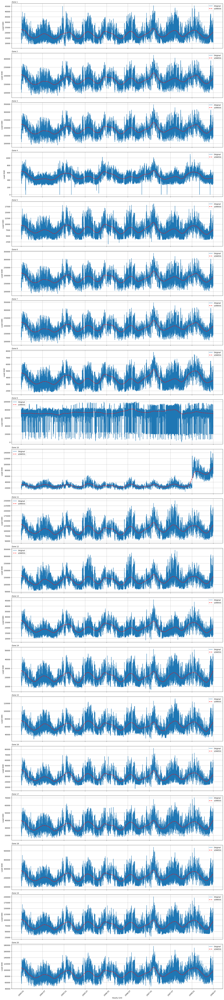

In [11]:
from statsmodels.nonparametric.smoothers_lowess import lowess
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

zones = load_long["zone_id"].unique()
fig, axes = plt.subplots(nrows=20, ncols=1, figsize=(18, 80), sharex=True)

for ax, zone in zip(axes, zones):
    zone_data = load_long[load_long["zone_id"] == zone].copy()
    
    # Plot original line
    sns.lineplot(data=zone_data, x="timestamp", y="load", ax=ax, label="Original")

    # Convert timestamp to numeric (seconds since epoch)
    exog = zone_data["timestamp"].astype("int64") / 1e9

    # Apply LOWESS smoothing
    smoothed = lowess(
        endog=zone_data["load"],
        exog=exog,
        frac=0.05  # adjust as needed
    )

    # Plot the LOWESS curve
    ax.plot(
        pd.to_datetime(smoothed[:, 0], unit='s'),
        smoothed[:, 1],
        color='red',
        linestyle='--',
        linewidth=2,
        label='LOWESS'
    )

    ax.set_title(f"Zone {zone}", loc="left", fontsize=10)
    ax.set_xlabel("Hourly (1H)")
    ax.set_ylabel("Load (kW)")
    ax.grid(True)
    ax.tick_params(axis="x", rotation=45)
    ax.legend()

plt.tight_layout()

# Exporting the image
plt.savefig('Complete_Load_Dist_by_zone.jpg') # Saves as a JPEG image
plt.show()

- There appears to be no significant trend in the data, throughout most zones.
- Mean changes appear to arise from seasonality, hence the series are non-stationary.
- Variance appears to be changing only because of the seasonal component in most zones.
- In some zones the trend seems to be positive, but only very slightly (for example: zones 8, 11, 14, 15)
- There does appear to be strong presence of seasonality (monthly variations each year are similar).
- Cyclicity does not exist since for all zones, the load values are increasing or decreasing by a fixed amount each year.
- For cyclicity to exist, we need values in similar range across multiple years.

We would like to maintain granularity at the hourly level. So, plots for aggregated load values are not explored here.

### Zone 1
Here, only zone 1 is explored. Load Values are observed over different components of a calendar i.e. hour, day, week, month, year. 

#### Variation within an Year

In [12]:
# There are unique years in the data
load_long.year.unique()

array([2004, 2005, 2006, 2007, 2008], dtype=int64)

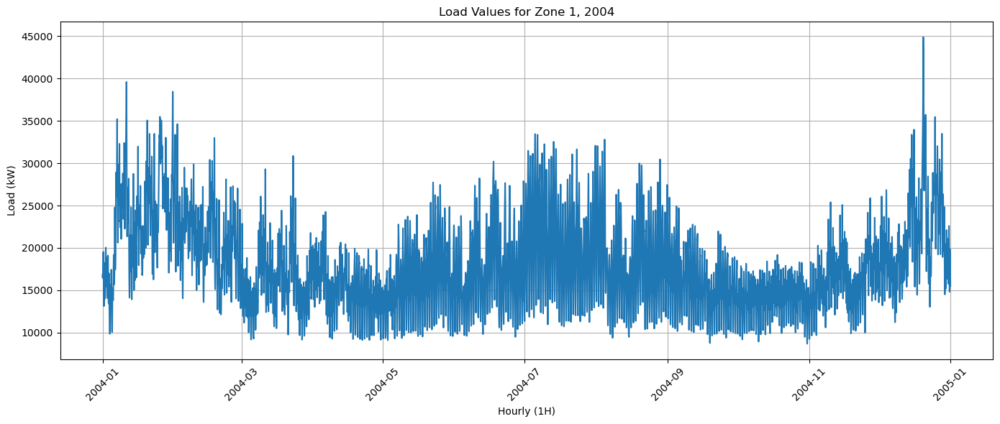

In [13]:
# Zone 1: 2004 only

fig, ax = plt.subplots(figsize=(14, 6))

sns.lineplot(data=load_long.query('(year == 2004) & (zone_id == 1)'), x="timestamp", y="load", ax=ax)
ax.set_title("Load Values for Zone 1, 2004")
ax.set_xlabel("Hourly (1H)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x", rotation=45)

plt.tight_layout()
plt.show()

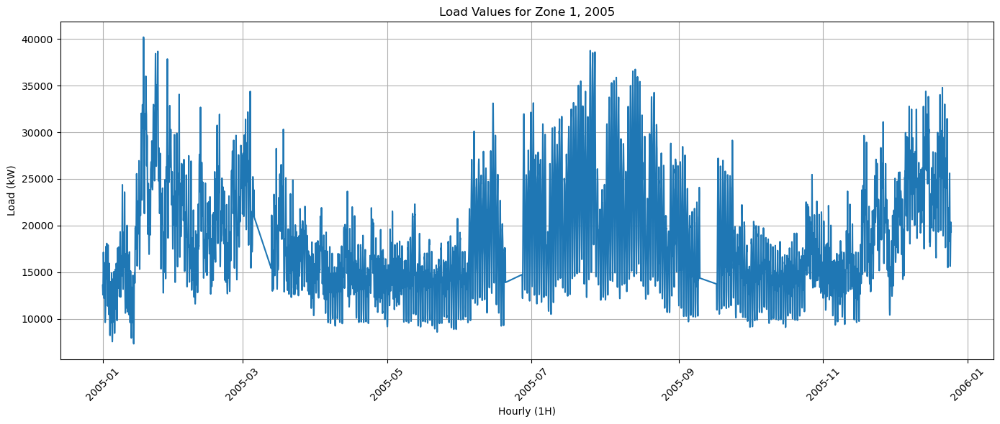

In [14]:
# Zone 1: 2005 only

fig, ax = plt.subplots(figsize=(14, 6))

sns.lineplot(data=load_long.query('(year == 2005) & (zone_id == 1)'), x="timestamp", y="load", ax=ax)
ax.set_title("Load Values for Zone 1, 2005")
ax.set_xlabel("Hourly (1H)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x", rotation=45)

plt.tight_layout()
plt.show()

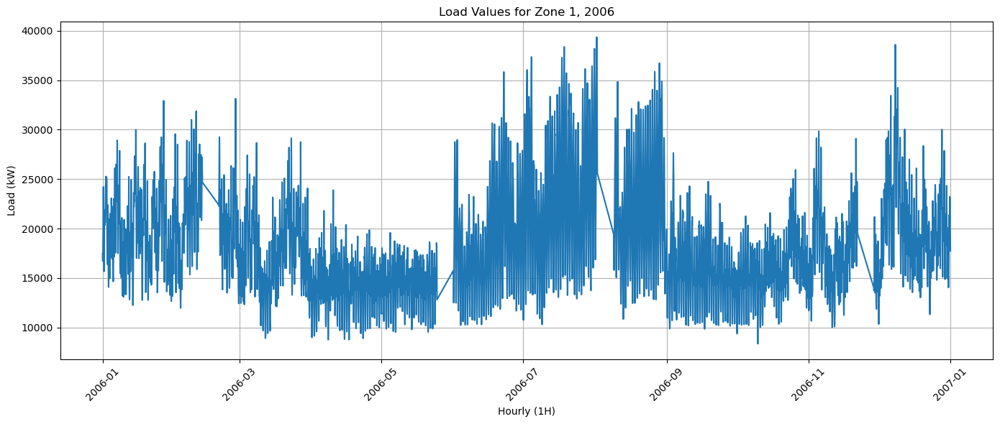

In [15]:
# Zone 1: 2006 only

fig, ax = plt.subplots(figsize=(14, 6))

sns.lineplot(data=load_long.query('(year == 2006) & (zone_id == 1)'), x="timestamp", y="load", ax=ax)
ax.set_title("Load Values for Zone 1, 2006")
ax.set_xlabel("Hourly (1H)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x", rotation=45)

plt.tight_layout()
plt.show()

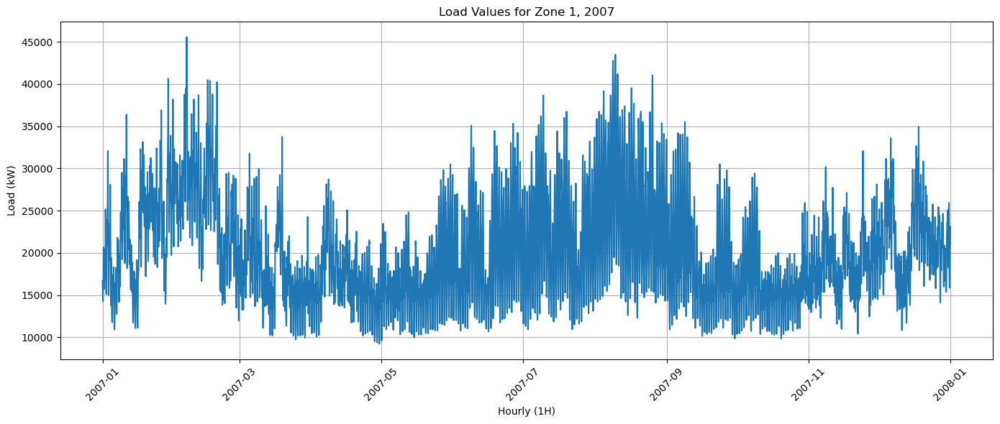

In [16]:
# Zone 1: 2007 only

fig, ax = plt.subplots(figsize=(14, 6))

sns.lineplot(data=load_long.query('(year == 2007) & (zone_id == 1)'), x="timestamp", y="load", ax=ax)
ax.set_title("Load Values for Zone 1, 2007")
ax.set_xlabel("Hourly (1H)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x", rotation=45)

plt.tight_layout()
plt.show()

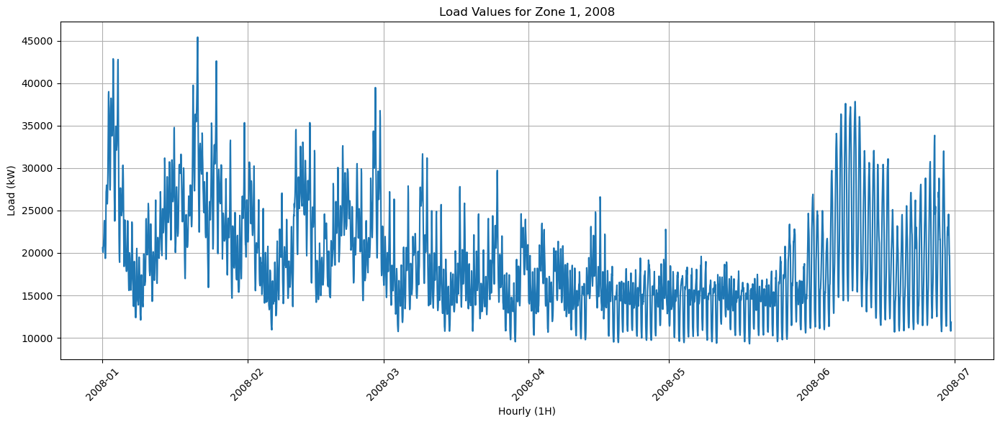

In [17]:
# Zone 1: 2008 only

fig, ax = plt.subplots(figsize=(14, 6))

sns.lineplot(data=load_long.query('(year == 2008) & (zone_id == 1)'), x="timestamp", y="load", ax=ax)
ax.set_title("Load Values for Zone 1, 2008")
ax.set_xlabel("Hourly (1H)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x", rotation=45)

plt.tight_layout()
plt.show()

The data for 2008 is not available for the entire year, so seasonality should be checked either till end of 2007, or till the middle of 2008.

Where does Seasonality seem to appear?
- Load values seem to be low at year beginning (Jan)
- Typically, they tend to rise as we move to Feb
- From Feb onwards, values begin to decrease till end of Apr, start of May
- From that onwards, they tend to increase till start of August
- ....

Having presence of monthly seasonality could mean that load values are dependent on temperature values (average temperatures typically change with seasons).

#### Variation By Month
Here instead of taking the complete year, data is read over four years (2004-2007), monthly. <br>
<b>Note:</b> Data is aggregated over days of a month, instead of hourly values.

In [18]:
# Aggregating hourly data by month - 2004
load_long_magg_2004 = load_long.query('(zone_id == 1) & (year == 2004)').groupby(load_long["timestamp"].dt.month)["load"].agg("mean").reset_index()
load_long_magg_2004.rename(columns={"timestamp": "month", "load": "avg_load"}, inplace=True)
load_long_magg_2004["year"] = 2004
load_long_magg_2004

,month,avg_load,year
0,1,23103.259409,2004
1,2,20890.150862,2004
2,3,15731.619624,2004
3,4,14756.133333,2004
4,5,16124.403226,2004
5,6,17401.673611,2004
6,7,20532.204301,2004
7,8,18434.290323,2004
8,9,15447.952778,2004
9,10,13844.700269,2004


In [19]:
# Aggregating hourly data by month - 2005
load_long_magg_2005 = load_long.query('(zone_id == 1) & (year == 2005)').groupby(load_long["timestamp"].dt.month)["load"].agg("mean").reset_index()
load_long_magg_2005.rename(columns={"timestamp": "month", "load": "avg_load"}, inplace=True)
load_long_magg_2005["year"] = 2005

# Aggregating hourly data by month - 2006
load_long_magg_2006 = load_long.query('(zone_id == 1) & (year == 2006)').groupby(load_long["timestamp"].dt.month)["load"].agg("mean").reset_index()
load_long_magg_2006.rename(columns={"timestamp": "month", "load": "avg_load"}, inplace=True)
load_long_magg_2006["year"] = 2006

# Aggregating hourly data by month - 2007
load_long_magg_2007 = load_long.query('(zone_id == 1) & (year == 2007)').groupby(load_long["timestamp"].dt.month)["load"].agg("mean").reset_index()
load_long_magg_2007.rename(columns={"timestamp": "month", "load": "avg_load"}, inplace=True)
load_long_magg_2007["year"] = 2007

# Aggregating hourly data by month - 2008
load_long_magg_2008 = load_long.query('(zone_id == 1) & (year == 2008)').groupby(load_long["timestamp"].dt.month)["load"].agg("mean").reset_index()
load_long_magg_2008.rename(columns={"timestamp": "month", "load": "avg_load"}, inplace=True)
load_long_magg_2008["year"] = 2008

load_long_magg = pd.concat([load_long_magg_2004,load_long_magg_2005,load_long_magg_2006,load_long_magg_2007,load_long_magg_2008], ignore_index=True)
load_long_magg.head()

,month,avg_load,year
0,1,23103.259409,2004
1,2,20890.150862,2004
2,3,15731.619624,2004
3,4,14756.133333,2004
4,5,16124.403226,2004


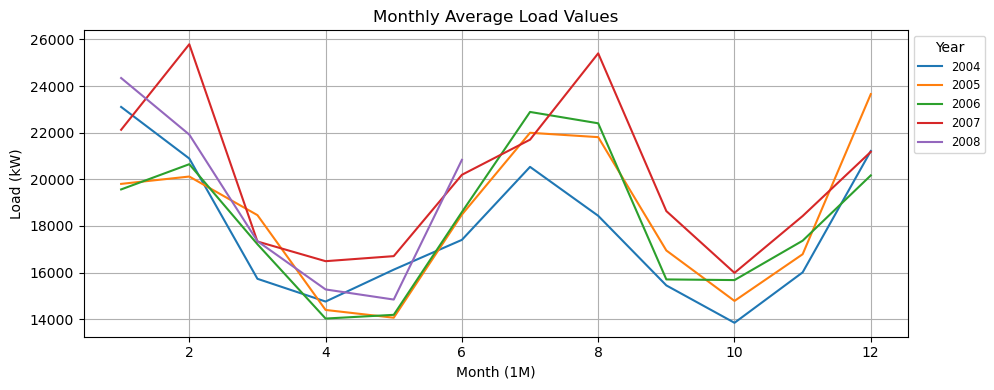

In [20]:
# Zone 1: All Years, Monthly Aggregated

fig, ax = plt.subplots(figsize=(10, 4))

sns.lineplot(data=load_long_magg, x="month", y="avg_load", ax=ax, hue='year', palette="tab10")
ax.set_title("Monthly Average Load Values")
ax.set_xlabel("Month (1M)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Year",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

The plot reveals that seasonality does not exactly appear in month, but seems to appear more by quarter.

#### Daily Variation
Do some days or part of month show greater values than others parts?

In [21]:
# Aggregating hourly data for 2004 - Jan

load_long_dagg_2004_jan = load_long.query('(zone_id == 1) & (year == 2004) & (month == 1)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_jan["month"] = 1
load_long_dagg_2004_jan.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Feb
load_long_dagg_2004_feb = load_long.query('(zone_id == 1) & (year == 2004) & (month == 2)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_feb["month"] = 2
load_long_dagg_2004_feb.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Mar
load_long_dagg_2004_mar = load_long.query('(zone_id == 1) & (year == 2004) & (month == 3)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_mar["month"] = 3
load_long_dagg_2004_mar.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Apr
load_long_dagg_2004_apr = load_long.query('(zone_id == 1) & (year == 2004) & (month == 4)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_apr["month"] = 4
load_long_dagg_2004_apr.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - May
load_long_dagg_2004_may = load_long.query('(zone_id == 1) & (year == 2004) & (month == 5)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_may["month"] = 5
load_long_dagg_2004_may.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Jun
load_long_dagg_2004_jun = load_long.query('(zone_id == 1) & (year == 2004) & (month == 6)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_jun["month"] = 6
load_long_dagg_2004_jun.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - July
load_long_dagg_2004_jul = load_long.query('(zone_id == 1) & (year == 2004) & (month == 7)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_jul["month"] = 7
load_long_dagg_2004_jul.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

load_long_dagg = pd.concat([load_long_dagg_2004_jan,load_long_dagg_2004_feb,load_long_dagg_2004_mar,load_long_dagg_2004_apr,load_long_dagg_2004_may,load_long_dagg_2004_jun,load_long_dagg_2004_jul], ignore_index=True)
load_long_dagg.head()

,day,avg_load,month
0,1,16703.333333,1
1,2,17006.541667,1
2,3,15279.000000,1
3,4,13561.041667,1
4,5,14479.958333,1


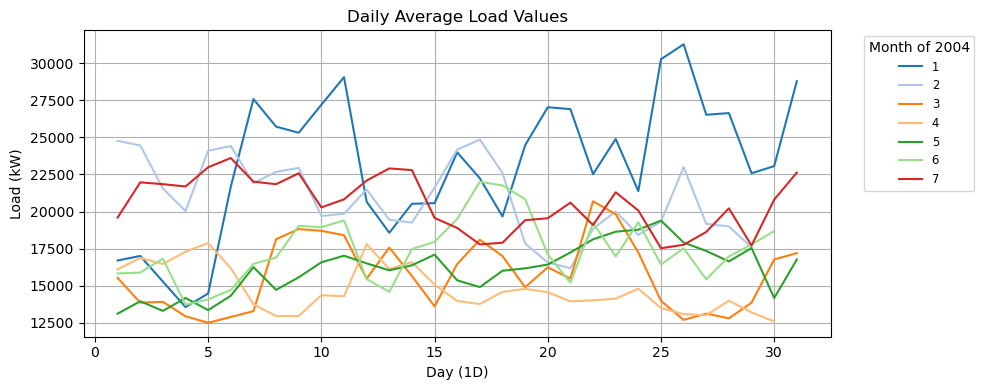

In [22]:
# Zone 1: 2004, Aggregated by Days

fig, ax = plt.subplots(figsize=(10, 4))

sns.lineplot(data=load_long_dagg, x="day", y="avg_load", ax=ax, hue='month', palette="tab20")
ax.set_title("Daily Average Load Values")
ax.set_xlabel("Day (1D)")
ax.set_ylabel("Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Month of 2004",
    bbox_to_anchor=(1.2, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

- There is no seasonality or trend that appears on a daily level.
- No seasonality seems to appear based on portion of month in terms of week
- For example, when moving from 5th to 15th look at red line v/s dark green line

#### Variation By Day of Week - Intermonth Comparison
Note: Data is aggregated by day of the week, instead of hourly values.

In [23]:
# Aggregating hourly data for 2004 - Aug
load_long_dagg_2004_aug = load_long.query('(zone_id == 1) & (year == 2004) & (month == 8)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_aug["month"] = 8
load_long_dagg_2004_aug.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Sep
load_long_dagg_2004_sep = load_long.query('(zone_id == 1) & (year == 2004) & (month == 9)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_sep["month"] = 9
load_long_dagg_2004_sep.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Oct
load_long_dagg_2004_oct = load_long.query('(zone_id == 1) & (year == 2004) & (month == 10)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_oct["month"] = 10
load_long_dagg_2004_oct.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Nov
load_long_dagg_2004_nov = load_long.query('(zone_id == 1) & (year == 2004) & (month == 11)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_nov["month"] = 11
load_long_dagg_2004_nov.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

# Aggregating hourly data for 2004 - Dec
load_long_dagg_2004_dec = load_long.query('(zone_id == 1) & (year == 2004) & (month == 12)').groupby(load_long["timestamp"].dt.day)["load"].agg("mean").reset_index()
load_long_dagg_2004_dec["month"] = 12
load_long_dagg_2004_dec.rename(columns={"timestamp": "day", "load": "avg_load"}, inplace=True)

load_long_dagg = pd.concat([load_long_dagg_2004_jan,
                            load_long_dagg_2004_feb,
                            load_long_dagg_2004_mar,
                            load_long_dagg_2004_apr,
                            load_long_dagg_2004_may,
                            load_long_dagg_2004_jun,
                            load_long_dagg_2004_jul,
                            load_long_dagg_2004_aug,
                            load_long_dagg_2004_sep,
                            load_long_dagg_2004_oct,
                            load_long_dagg_2004_nov,
                            load_long_dagg_2004_dec], ignore_index=True)

load_long_dagg.head()

,day,avg_load,month
0,1,16703.333333,1
1,2,17006.541667,1
2,3,15279.000000,1
3,4,13561.041667,1
4,5,14479.958333,1


In [24]:
# Generating Day of Week

load_long_dagg["year"] = 2004
load_long_dagg['date'] = pd.to_datetime(load_long_dagg[['year', 'month', 'day']])
load_long_dagg['weekday'] = load_long_dagg['date'].dt.day_name()
load_long_dagg.head()

,day,avg_load,month,year,date,weekday
0,1,16703.333333,1,2004,2004-01-01,Thursday
1,2,17006.541667,1,2004,2004-01-02,Friday
2,3,15279.000000,1,2004,2004-01-03,Saturday
3,4,13561.041667,1,2004,2004-01-04,Sunday
4,5,14479.958333,1,2004,2004-01-05,Monday


In [25]:
# Generating Week number

load_long_dagg['week_number'] = load_long_dagg['date'].dt.isocalendar().week
load_long_dagg['week_number'] = load_long_dagg['week_number'].astype(int)
load_long_dagg.head()

,day,avg_load,month,year,date,weekday,week_number
0,1,16703.333333,1,2004,2004-01-01,Thursday,1
1,2,17006.541667,1,2004,2004-01-02,Friday,1
2,3,15279.000000,1,2004,2004-01-03,Saturday,1
3,4,13561.041667,1,2004,2004-01-04,Sunday,1
4,5,14479.958333,1,2004,2004-01-05,Monday,2


In [26]:
# Defining order of data

weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
load_long_dagg['weekday'] = pd.Categorical(load_long_dagg['weekday'], categories=weekday_order, ordered=True)
load_long_dagg.head()

,day,avg_load,month,year,date,weekday,week_number
0,1,16703.333333,1,2004,2004-01-01,Thursday,1
1,2,17006.541667,1,2004,2004-01-02,Friday,1
2,3,15279.000000,1,2004,2004-01-03,Saturday,1
3,4,13561.041667,1,2004,2004-01-04,Sunday,1
4,5,14479.958333,1,2004,2004-01-05,Monday,2


In [27]:
# Converting weekday into numeric

weekday_map = {
    "Monday": 1,
    "Tuesday": 2,
    "Wednesday": 3,
    "Thursday": 4,
    "Friday": 5,
    "Saturday": 6,
    "Sunday": 7
}

load_long_dagg['weekday_num'] = load_long_dagg['weekday'].map(weekday_map)
load_long_dagg.head()

,day,avg_load,month,year,date,weekday,week_number,weekday_num
0,1,16703.333333,1,2004,2004-01-01,Thursday,1,4
1,2,17006.541667,1,2004,2004-01-02,Friday,1,5
2,3,15279.000000,1,2004,2004-01-03,Saturday,1,6
3,4,13561.041667,1,2004,2004-01-04,Sunday,1,7
4,5,14479.958333,1,2004,2004-01-05,Monday,2,1


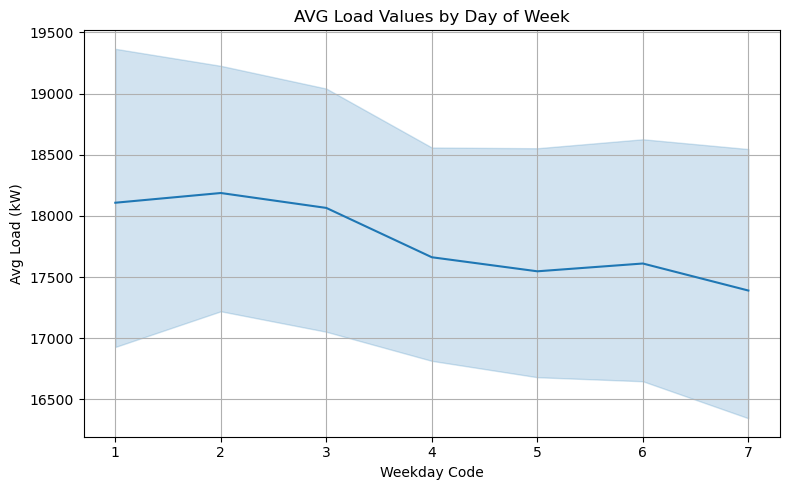

In [28]:
# Zone 1: 2004, Day of Week (Agg by Day)

fig, ax = plt.subplots(figsize=(8, 5))

sns.lineplot(data=load_long_dagg, x="weekday_num", y="avg_load", ax=ax)
ax.set_title("AVG Load Values by Day of Week")
ax.set_xlabel("Weekday Code")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

It appears that load values are going down, on average, during the weekend. This must be seen at a more granular level.

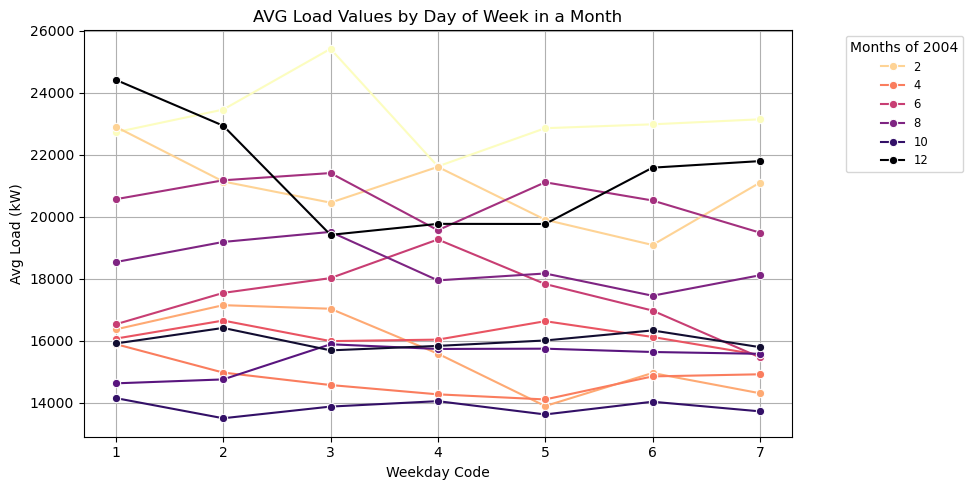

In [29]:
# Zone 1: All months of 2004, Day of Week (Agg by Day)

fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=load_long_dagg.query('year == 2004'), x="weekday_num", y="avg_load", ax=ax, hue="month", palette="magma_r",marker='o',errorbar=None)
ax.set_title("AVG Load Values by Day of Week in a Month")
ax.set_xlabel("Weekday Code")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Months of 2004",
    bbox_to_anchor=(1.25, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

In this plot, the average value for a weekday in a month is plotted. <br>
- It is again seen that seasonality appears to exist more due to monthly variation
- Seasonality does not seem to appear, based on day of week
- For Example, moving from Tuesday to Wednesday leads to both increase and decrease
- Same can be said when moving from Thur-Fri & Sat-Sun, for a given month

#### Variation By Day of Week - Intramonth Comparison
Here the variation of day of week is studied within a given month to see if at a more macroscopic level, this variation shows any pattern or not. 

In [30]:
# Jan 2004, Zone 1
z1_jan04 = load_long.loc[(load_long.month==1)&(load_long.year==2004)&(load_long.zone_id==1),]

# Generating Day of Week
z1_jan04['date'] = pd.to_datetime(z1_jan04[['year', 'month', 'day']])
z1_jan04['weekday'] = z1_jan04['date'].dt.day_name()
z1_jan04["week_num"] = z1_jan04['date'].dt.isocalendar().week
z1_jan04.head()

C:\Users\singh\AppData\Local\Temp\ipykernel_31576\1265630848.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  z1_jan04['date'] = pd.to_datetime(z1_jan04[['year', 'month', 'day']])
C:\Users\singh\AppData\Local\Temp\ipykernel_31576\1265630848.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  z1_jan04['weekday'] = z1_jan04['date'].dt.day_name()
C:\Users\singh\AppData\Local\Temp\ipykernel_31576\1265630848.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

,zone_id,year,month,day,hour,load,timestamp,date,weekday,week_num
0,1,2004,1,1,00:30,16853.0,2004-01-01 00:30:00,2004-01-01,Thursday,1
1,1,2004,1,2,00:30,14155.0,2004-01-02 00:30:00,2004-01-02,Friday,1
2,1,2004,1,3,00:30,14439.0,2004-01-03 00:30:00,2004-01-03,Saturday,1
3,1,2004,1,4,00:30,11273.0,2004-01-04 00:30:00,2004-01-04,Sunday,1
4,1,2004,1,5,00:30,10750.0,2004-01-05 00:30:00,2004-01-05,Monday,2


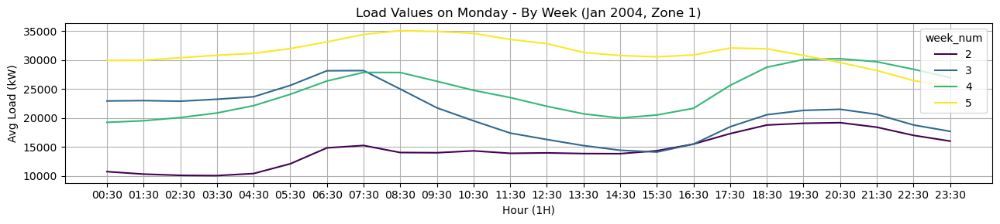

In [31]:
# Zone 1: 2004, Jan (Mondays)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Monday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Monday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

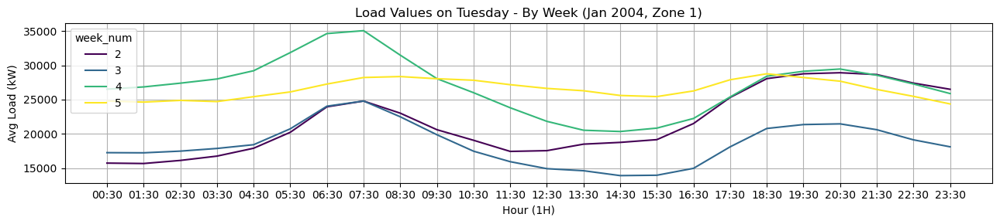

In [32]:
# Zone 1: 2004, Jan (Tuesdays)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Tuesday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Tuesday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

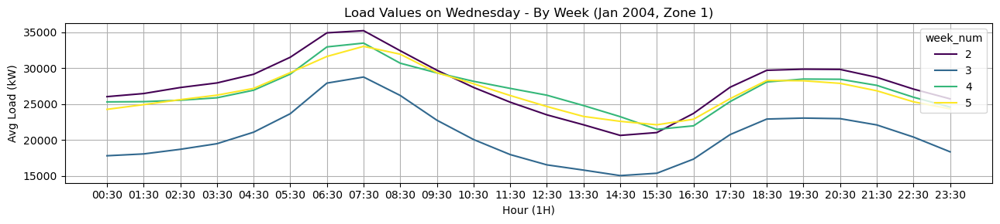

In [33]:
# Zone 1: 2004, Jan (Wednesdays)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Wednesday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Wednesday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

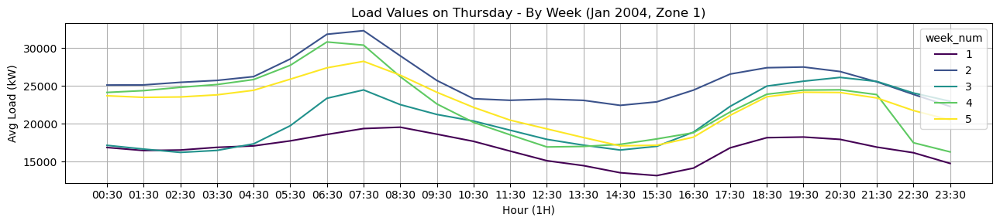

In [34]:
# Zone 1: 2004, Jan (Thursday)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Thursday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Thursday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

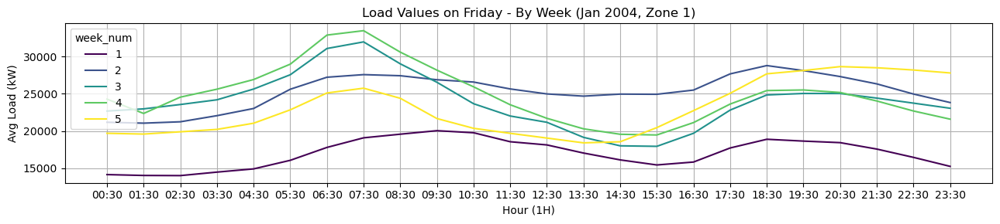

In [35]:
# Zone 1: 2004, Jan (Friday)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Friday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Friday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

Looks like all weekdays have similar daily load pattern, irrespective of what weekday it is anyways.

But what about weekend? Is the usage pattern significantly different compared to weekdays?

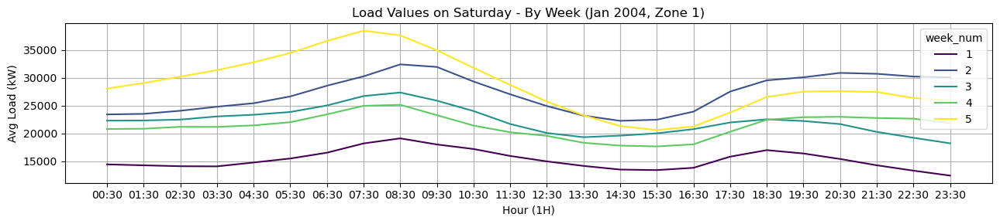

In [36]:
# Zone 1: 2004, Jan (Saturdays)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Saturday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Saturday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

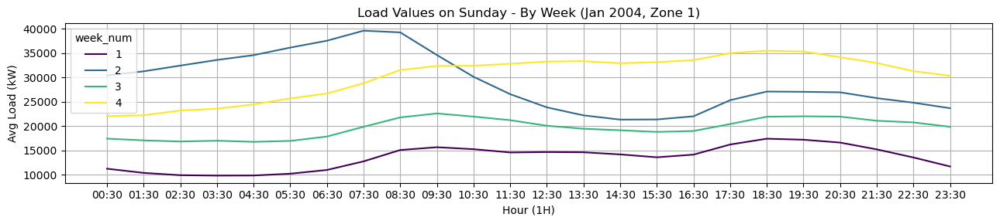

In [37]:
# Zone 1: 2004, Jan (Sundays)

fig, ax = plt.subplots(figsize=(13, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.weekday=="Sunday",], x="hour", y="load", ax=ax, hue="week_num", palette="viridis")
ax.set_title("Load Values on Sunday - By Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

The distribution at the weekend does not appear to be as different compared to the Weekdays.<br>
For a given Saturday, the previous day (Friday) might provide just as much or even better information than previous Saturday.

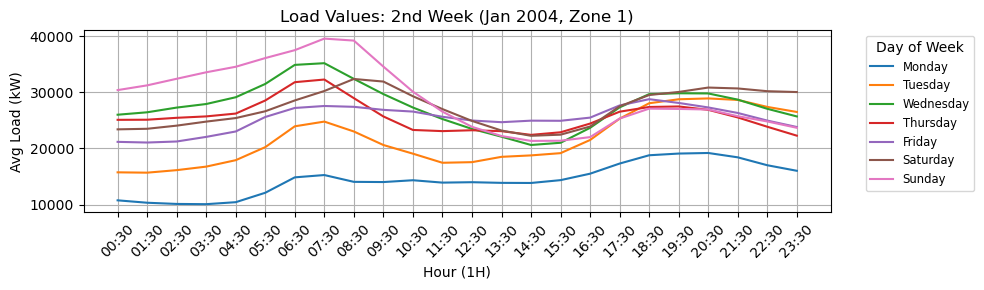

In [38]:
# Example, comparing monday with saturday (week '2')

fig, ax = plt.subplots(figsize=(10, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.week_num==2,], x="hour", y="load", ax=ax, hue="weekday", palette="tab10")
ax.set_title("Load Values: 2nd Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x",rotation=45)

ax.legend(
    title="Day of Week",
    bbox_to_anchor=(1.2, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

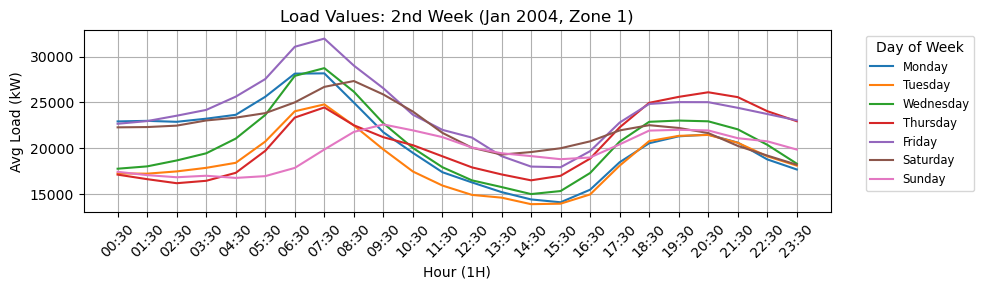

In [39]:
# Example, comparing monday with saturday (week '3')

fig, ax = plt.subplots(figsize=(10, 3))

sns.lineplot(data=z1_jan04.loc[z1_jan04.week_num==3,], x="hour", y="load", ax=ax, hue="weekday", palette="tab10")
ax.set_title("Load Values: 2nd Week (Jan 2004, Zone 1)")
ax.set_xlabel("Hour (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x",rotation=45)

ax.legend(
    title="Day of Week",
    bbox_to_anchor=(1.2, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

#### Seasonal Mini Time Plot
The seasonality is captured here using monthly mini-plots as shown in this section.

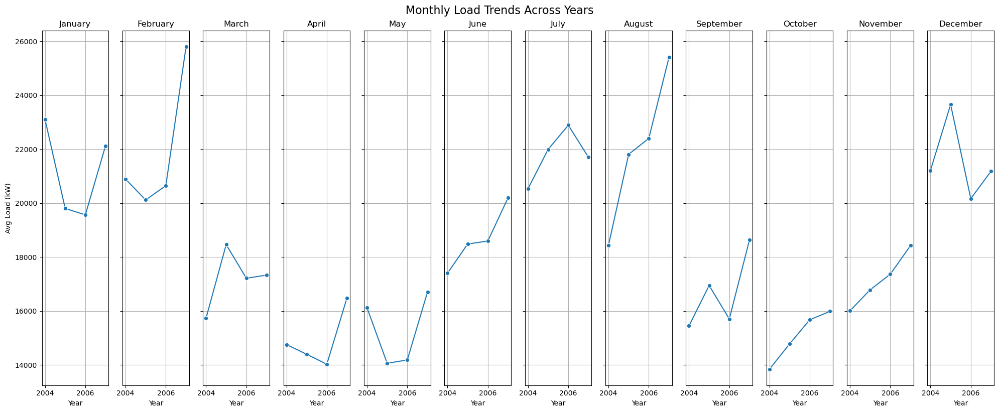

In [40]:
# Generating Miniplot for monthly seasonality

import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Set up the subplot grid
fig, axes = plt.subplots(nrows=1, ncols=12, figsize=(20, 8), sharey=True)
axes = axes.flatten()

# Optional: Month name map for titles
month_names = {
    1: 'January', 2: 'February', 3: 'March', 4: 'April',
    5: 'May', 6: 'June', 7: 'July', 8: 'August',
    9: 'September', 10: 'October', 11: 'November', 12: 'December'
}

for month in range(1, 13):
    ax = axes[month - 1]
    month_data = load_long_magg[load_long_magg['month'] == month]
    
    sns.lineplot(data=month_data.query('year < 2008'), x='year', y='avg_load', ax=ax, marker='o')
    ax.set_title(month_names[month])
    ax.set_xlabel('Year')
    ax.set_ylabel('Avg Load (kW)')
    ax.grid(True)

plt.tight_layout()
plt.suptitle('Monthly Load Trends Across Years', fontsize=16, y=1.02)
plt.show()

Here again, seasonality is not exactly captured at a monthly level because there is no absolute pattern of increase or decrease.

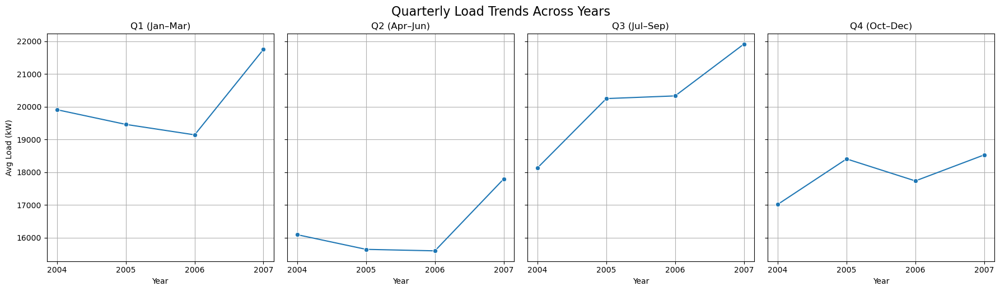

In [41]:
# Generating Miniplot for seasonality at quarterly level

load_long_magg['year'] = load_long_magg['year'].round().astype(int)

# Manually assign quarter from month
load_long_magg['quarter'] = load_long_magg['month'].apply(lambda m: (m - 1) // 3 + 1)

# Set up subplot grid: one plot per quarter
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(18, 5), sharey=True)
axes = axes.flatten()

quarter_names = {
    1: 'Q1 (Jan–Mar)', 
    2: 'Q2 (Apr–Jun)', 
    3: 'Q3 (Jul–Sep)', 
    4: 'Q4 (Oct–Dec)'
}

for q in range(1, 5):
    ax = axes[q - 1]
    q_data = load_long_magg.query('year<2008')[load_long_magg.query('year<2008')['quarter'] == q]
    
    sns.lineplot(
        data=q_data,
        x='year',
        y='avg_load',
        marker='o',
        ax=ax,
        errorbar=None
    )
    
    ax.set_title(quarter_names[q])
    ax.set_xlabel('Year')
    ax.set_ylabel('Avg Load (kW)')
    ax.grid(True)

for ax in axes:
    ax.set_xticks(sorted(load_long_magg.query('year < 2008')['year'].unique()))

plt.tight_layout()
plt.suptitle('Quarterly Load Trends Across Years', fontsize=16, y=1.03)
plt.show()

#### Variation at an hourly level
Till now, we have seen seasonality mainly occur at a monthly/quarterly level. But what about there existing seasonality at a more granular <i>hourly</i> level?

In [42]:
# Observing hourly data for Zone 1, Jan 2004
load_long.query('(year==2004)&(zone_id==1)&(month==1)').head()

,zone_id,year,month,day,hour,load,timestamp
0,1,2004,1,1,00:30,16853.0,2004-01-01 00:30:00
1,1,2004,1,2,00:30,14155.0,2004-01-02 00:30:00
2,1,2004,1,3,00:30,14439.0,2004-01-03 00:30:00
3,1,2004,1,4,00:30,11273.0,2004-01-04 00:30:00
4,1,2004,1,5,00:30,10750.0,2004-01-05 00:30:00


In [43]:
# 31 days * 24 hrs = 744
len(load_long.query('(year==2004)&(zone_id==1)&(month==1)'))

744

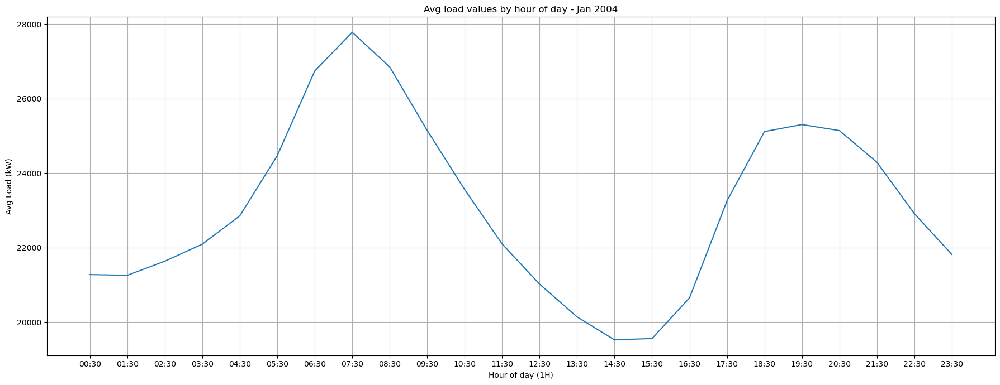

In [44]:
# Zone 1: Jan 2004 (31 days hourly data)

fig, ax = plt.subplots(figsize=(18, 7))

sns.lineplot(data=load_long.query('(year==2004)&(zone_id==1)&(month==1)'), x="hour", y="load", ax=ax,errorbar=None)
ax.set_title("Avg load values by hour of day - Jan 2004" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

plt.tight_layout()
plt.show()

In [45]:
# Verifying the plot values
import numpy as np

for i in load_long.hour.unique():
    print(np.mean(load_long.loc[(load_long.year==2004)&(load_long.zone_id==1)&(load_long.month==1)&(load_long.hour==i), 'load']).round(0), f'[{i}]')

21276.0 [00:30]
21257.0 [01:30]
21636.0 [02:30]
22093.0 [03:30]
22853.0 [04:30]
24467.0 [05:30]
26741.0 [06:30]
27778.0 [07:30]
26850.0 [08:30]
25146.0 [09:30]
23558.0 [10:30]
22099.0 [11:30]
21020.0 [12:30]
20140.0 [13:30]
19524.0 [14:30]
19561.0 [15:30]
20652.0 [16:30]
23253.0 [17:30]
25114.0 [18:30]
25302.0 [19:30]
25141.0 [20:30]
24292.0 [21:30]
22910.0 [22:30]
21817.0 [23:30]


There does appear to be seasonality existing at an hourly level as well!<br>
The evidence would be strong if the same is observed over multiple months.

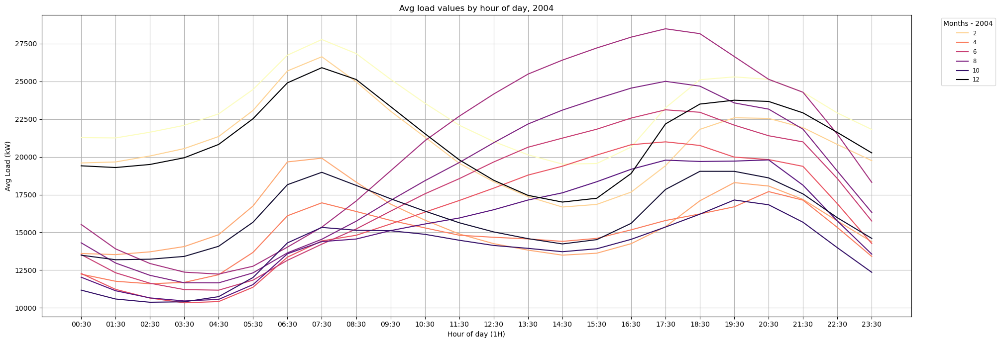

In [46]:
# Zone 1: All Months

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2004)&(zone_id==1)'), x="hour", y="load", ax=ax,hue='month',palette='magma_r',errorbar=None)
ax.set_title("Avg load values by hour of day, 2004" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Months - 2004",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

- There does appear to be seasonality in hour
- The pattern seems to change a little between 7:30 and 18:30 (11h window), as yearly seasons change
- Both initial and end months seem to have similar pattern, meaning the pattern change is happening in the middle (summer) months
- Hence, there appears to be two types of seasonality here

One way to check about this combination of seasonality is to see if it also happens for 2025

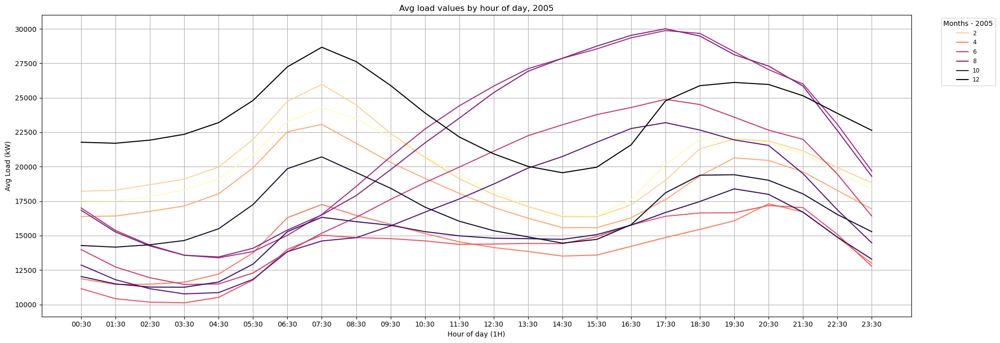

In [47]:
# Zone 1: 2005

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2005)&(zone_id==1)'), x="hour", y="load", ax=ax,hue='month',palette='magma_r',errorbar=None)
ax.set_title("Avg load values by hour of day, 2005" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Months - 2005",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

The same pattern as in 2004 is observed here.

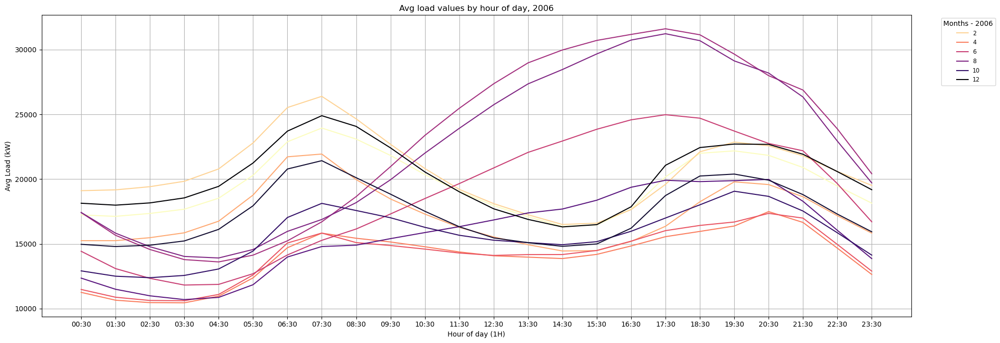

In [48]:
# Zone 1: 2006

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2006)&(zone_id==1)'), x="hour", y="load", ax=ax,hue='month',palette='magma_r',errorbar=None)
ax.set_title("Avg load values by hour of day, 2006" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Months - 2006",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

Again, as in 2004, only the middle (summer) months seem to change a little in hourly seasonality between 7:30 and 18:30

#### Capturing Hourly Variation - Segregated by "Season"
The plots above have shown that the hourly slightly varies between summer and winter months. The intent here is to capture them seperately.

<i> Year 2004 </i>

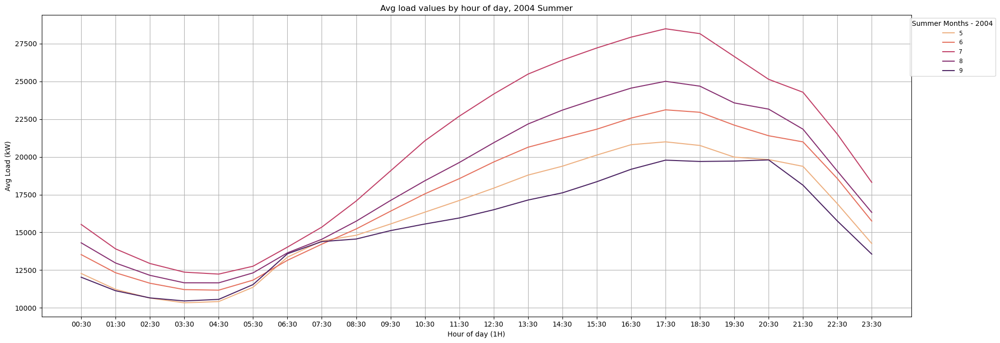

In [49]:
# Zone 1: 2004, Summer Months only (May-Sep)

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2004)&(zone_id==1)&(month>=5)&(month<=9)'), x="hour", y="load", ax=ax,hue='month',palette='flare',errorbar=None)
ax.set_title("Avg load values by hour of day, 2004 Summer" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Summer Months - 2004",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

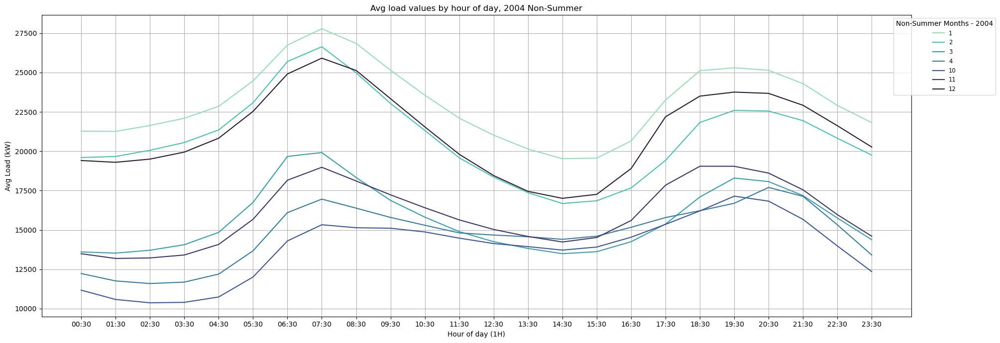

In [50]:
# Zone 1: 2004, Months other than May-Sep

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2004)&(zone_id==1)&((month < 5)|(month > 9))'), x="hour", y="load", ax=ax,hue=load_long.query('(year==2004)&(zone_id==1)&((month < 5)|(month > 9))').month.astype(str), palette='mako_r',errorbar=None)
ax.set_title("Avg load values by hour of day, 2004 Non-Summer" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Non-Summer Months - 2004",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

<i> Year 2005 </i>

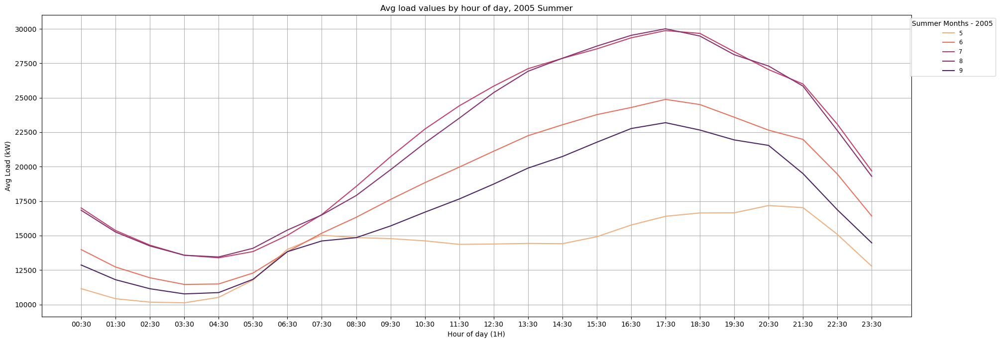

In [51]:
# Zone 1: 2005, Summer Months only (May-Sep)

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2005)&(zone_id==1)&(month>=5)&(month<=9)'), x="hour", y="load", ax=ax,hue='month',palette='flare',errorbar=None)
ax.set_title("Avg load values by hour of day, 2005 Summer" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Summer Months - 2005",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

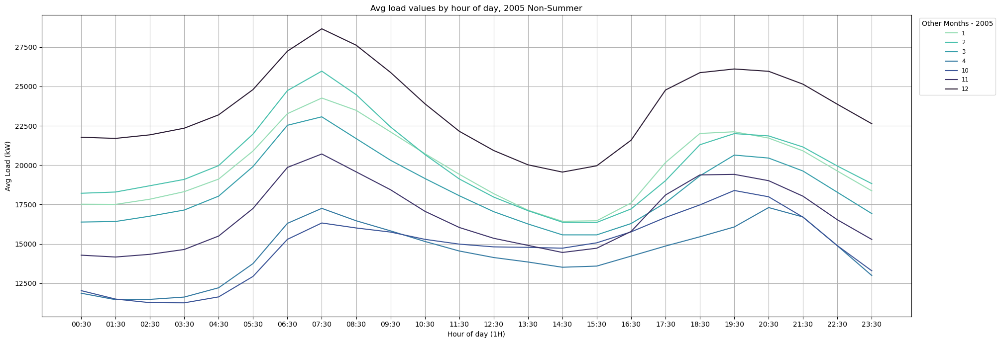

In [52]:
# Zone 1: 2005, Months other than May-Sep

fig, ax = plt.subplots(figsize=(20, 7))

sns.lineplot(data=load_long.query('(year==2005)&(zone_id==1)&((month < 5)|(month > 9))'), x="hour", y="load", ax=ax,hue=load_long.query('(year==2005)&(zone_id==1)&((month < 5)|(month > 9))').month.astype(str),palette='mako_r',errorbar=None)
ax.set_title("Avg load values by hour of day, 2005 Non-Summer" )
ax.set_xlabel("Hour of day (1H)")
ax.set_ylabel("Avg Load (kW)")
ax.grid(True)
ax.tick_params(axis="x")

ax.legend(
    title="Other Months - 2005",
    bbox_to_anchor=(1.1, 1),  # place legend outside right edge
    loc="upper right",
    fontsize="small",
    title_fontsize="medium"
)

plt.tight_layout()
plt.show()

### All Zones
Here, exploratory analysis is done between all the zones. The relationsips between the zones are also studied.

#### Monthly Variation
The hourly loads are averaged over a month.

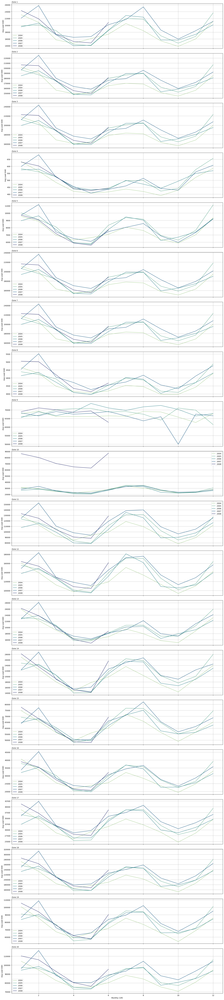

In [53]:
# Plotting avg monthly load for all zones

zones = load_long["zone_id"].unique()
fig, axes = plt.subplots(nrows=20, ncols=1, figsize=(18, 80), sharex=True)

for ax, zone in zip(axes, zones):
    zone_data = load_long[load_long["zone_id"] == zone].copy()
    
    # Plot original line
    sns.lineplot(data=zone_data, x="month", y="load", ax=ax,hue="year",errorbar=None,palette="crest")

    ax.set_title(f"Zone {zone}", loc="left", fontsize=10)
    ax.set_xlabel("Monthly (1M)")
    ax.set_ylabel("Avg Load (kW)")
    ax.grid(True)
    ax.tick_params(axis="x")
    ax.legend()

plt.tight_layout()
plt.show()

#### Correlation between Zones
This section is meant to do some scatterplot analysis to see which zones best correlate with each other. They can provide valuable information when forecasting future load.<br><br>
For this analysis, we would have to create a dataframe where the 20 zones are actually columns. That way, each row will represent a particular point in time.

In [54]:
# Data in the long form
load_long.head()

,zone_id,year,month,day,hour,load,timestamp
0,1,2004,1,1,00:30,16853.0,2004-01-01 00:30:00
1,1,2004,1,2,00:30,14155.0,2004-01-02 00:30:00
2,1,2004,1,3,00:30,14439.0,2004-01-03 00:30:00
3,1,2004,1,4,00:30,11273.0,2004-01-04 00:30:00
4,1,2004,1,5,00:30,10750.0,2004-01-05 00:30:00


In [55]:
# Pivoting the original dataframe on zone_id
load_long_pivot = load_long.pivot(index='timestamp', columns='zone_id', values='load')
load_long_pivot.columns = [f"zone_{z}" for z in load_long_pivot.columns]
load_long_pivot = load_long_pivot.reset_index()
load_long_pivot.head()

,timestamp,zone_1,zone_2,zone_3,zone_4,zone_5,zone_6,zone_7,zone_8,zone_9,...,zone_11,zone_12,zone_13,zone_14,zone_15,zone_16,zone_17,zone_18,zone_19,zone_20
0,2004-01-01 00:30:00,16853.0,126259.0,136233.0,484.0,6829.0,133088.0,136233.0,3124.0,75243.0,...,90700.0,118378.0,20673.0,21791.0,65970.0,28752.0,30645.0,200946.0,82298.0,79830.0
1,2004-01-01 01:30:00,16450.0,123313.0,133055.0,457.0,6596.0,129909.0,133055.0,2956.0,67368.0,...,86699.0,112480.0,19666.0,21400.0,64600.0,27851.0,30461.0,195835.0,79827.0,77429.0
2,2004-01-01 02:30:00,16517.0,119192.0,128608.0,450.0,6525.0,125717.0,128608.0,2953.0,64050.0,...,84243.0,108435.0,19020.0,20998.0,63843.0,27631.0,30197.0,194093.0,77728.0,75558.0
3,2004-01-01 03:30:00,16873.0,117507.0,126791.0,448.0,6654.0,124162.0,126791.0,2914.0,63861.0,...,84285.0,107224.0,18841.0,21214.0,64023.0,27986.0,30264.0,194708.0,76433.0,75709.0
4,2004-01-01 04:30:00,17064.0,118343.0,127692.0,444.0,6977.0,125320.0,127692.0,3221.0,75852.0,...,86087.0,108870.0,19310.0,21830.0,65679.0,29160.0,30907.0,202458.0,78172.0,77475.0


In [56]:
# Passing zone only information
load_long_pivot.iloc[:,1:].head()

,zone_1,zone_2,zone_3,zone_4,zone_5,zone_6,zone_7,zone_8,zone_9,zone_10,zone_11,zone_12,zone_13,zone_14,zone_15,zone_16,zone_17,zone_18,zone_19,zone_20
0,16853.0,126259.0,136233.0,484.0,6829.0,133088.0,136233.0,3124.0,75243.0,23339.0,90700.0,118378.0,20673.0,21791.0,65970.0,28752.0,30645.0,200946.0,82298.0,79830.0
1,16450.0,123313.0,133055.0,457.0,6596.0,129909.0,133055.0,2956.0,67368.0,22100.0,86699.0,112480.0,19666.0,21400.0,64600.0,27851.0,30461.0,195835.0,79827.0,77429.0
2,16517.0,119192.0,128608.0,450.0,6525.0,125717.0,128608.0,2953.0,64050.0,21376.0,84243.0,108435.0,19020.0,20998.0,63843.0,27631.0,30197.0,194093.0,77728.0,75558.0
3,16873.0,117507.0,126791.0,448.0,6654.0,124162.0,126791.0,2914.0,63861.0,21335.0,84285.0,107224.0,18841.0,21214.0,64023.0,27986.0,30264.0,194708.0,76433.0,75709.0
4,17064.0,118343.0,127692.0,444.0,6977.0,125320.0,127692.0,3221.0,75852.0,21564.0,86087.0,108870.0,19310.0,21830.0,65679.0,29160.0,30907.0,202458.0,78172.0,77475.0


In [57]:
load_long_pivot.shape

(39600, 21)

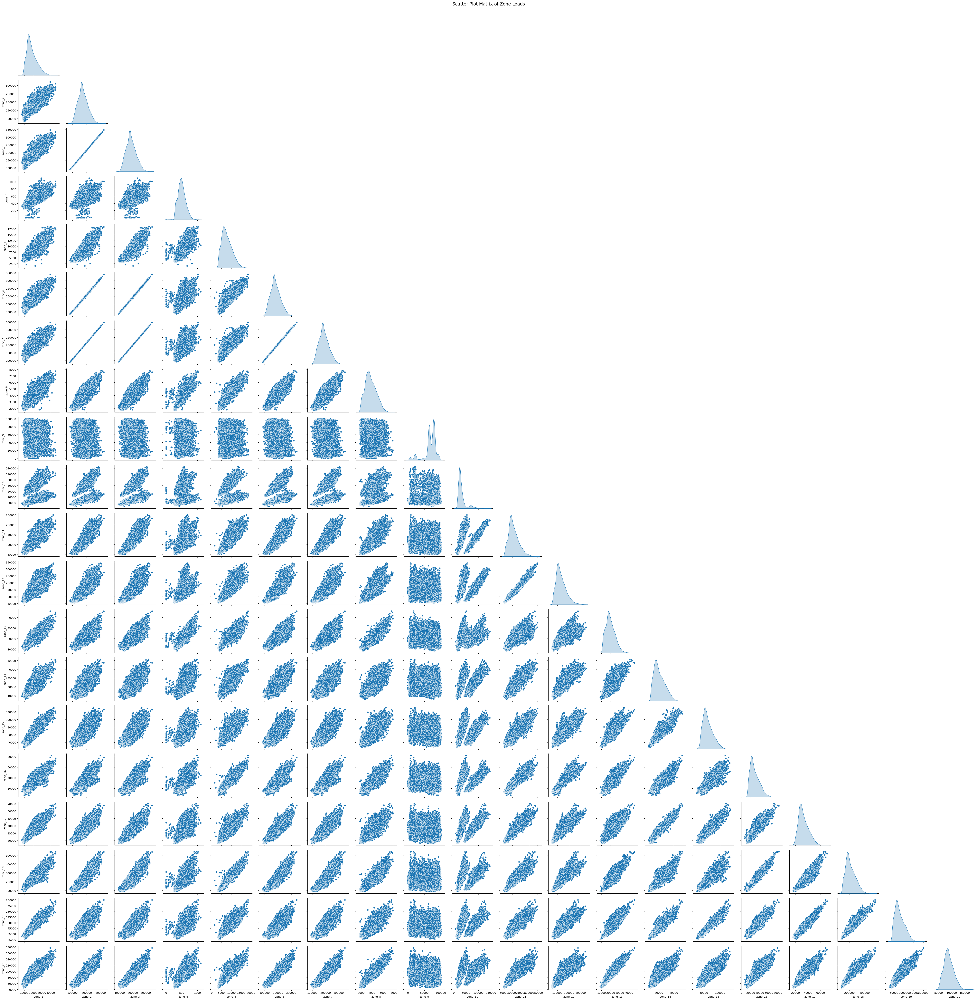

In [58]:
# Scatterplot Matrix - Pairplot

sns.pairplot(load_long_pivot.iloc[:,1:], diag_kind='kde', corner=True)
plt.suptitle("Scatter Plot Matrix of Zone Loads", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

- The problem only seems to exist in Zones: 4,9 and 10.
- In some instances, we see near perfect linearly positive relationship.
- In particular, load distribution of zone 9 and zone 10 are peculiar.

In [63]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

## Calculate the Correlation Matrix 
correlation_matrix_zone = load_long_pivot.iloc[:,1:].corr()
correlation_matrix_zone.head()

,zone_1,zone_2,zone_3,zone_4,zone_5,zone_6,zone_7,zone_8,zone_9,zone_10,zone_11,zone_12,zone_13,zone_14,zone_15,zone_16,zone_17,zone_18,zone_19,zone_20
zone_1,1.000000,0.862941,0.862941,0.737417,0.919036,0.873999,0.862941,0.870606,-0.262279,0.405172,0.907723,0.902031,0.862308,0.909565,0.929848,0.919915,0.933210,0.946835,0.953152,0.910538
zone_2,0.862941,1.000000,1.000000,0.730433,0.873148,0.999418,1.000000,0.874644,-0.275098,0.441967,0.905915,0.859347,0.839639,0.791394,0.804407,0.842541,0.875755,0.898301,0.839445,0.941964
zone_3,0.862941,1.000000,1.000000,0.730433,0.873148,0.999418,1.000000,0.874644,-0.275098,0.441967,0.905915,0.859347,0.839639,0.791394,0.804407,0.842541,0.875755,0.898301,0.839445,0.941964
zone_4,0.737417,0.730433,0.730433,1.000000,0.818830,0.742650,0.730433,0.880104,-0.150930,0.296777,0.690247,0.685426,0.887412,0.707244,0.665439,0.752836,0.676498,0.778405,0.739569,0.798865
zone_5,0.919036,0.873148,0.873148,0.818830,1.000000,0.889244,0.873148,0.916588,-0.219294,0.331173,0.892769,0.902932,0.892093,0.890968,0.865907,0.929896,0.886771,0.954057,0.921371,0.905234


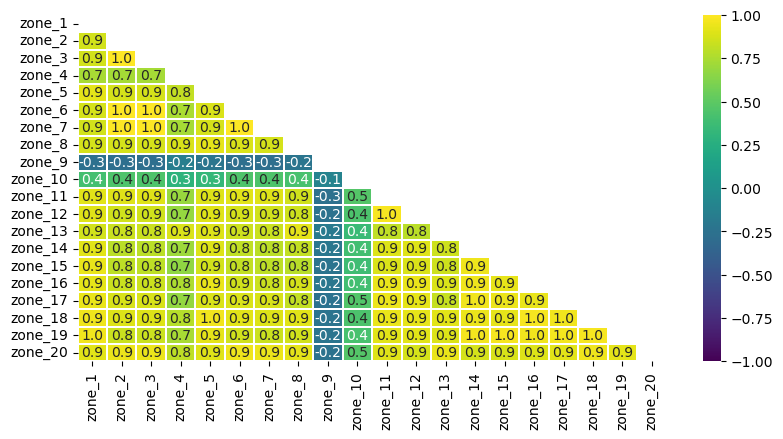

In [79]:
mask = np.triu(np.ones_like(correlation_matrix_zone, dtype=bool))

plt.figure(figsize=(9.5, 4.5))

sns.heatmap(
    correlation_matrix_zone,
    mask=mask,               # Apply the mask to hide the upper triangle
    annot=True,
    fmt=".1f",
    cmap='viridis',
    vmin=-1, 
    vmax=1, 
    linewidths=.01
)

plt.show()

#### Correlation with Temperature 
The Gefcom dataset also came with temperature readings. Considering seasonality patterns observed, temperature appears to be a strong predictor for load generated.

In [81]:
# Reading temperature csv

temperature = pd.read_csv(r"C:\Users\singh\Desktop\TUD (All Semesters)\Courses - Semester 6 (TU Dresden)\Thesis Work\Dataset\GEFCom2012\GEFCOM2012_Data\Load\temperature_history.csv")
temperature.head()

,station_id,year,month,day,h1,h2,h3,h4,h5,h6,...,h15,h16,h17,h18,h19,h20,h21,h22,h23,h24
0,1,2004,1,1,46,46,45,41,39,35,...,55.0,55.0,52.0,46.0,40.0,40.0,39.0,38.0,40.0,41.0
1,1,2004,1,2,43,44,46,46,47,47,...,54.0,56.0,57.0,53.0,50.0,47.0,46.0,45.0,45.0,45.0
2,1,2004,1,3,45,46,46,44,43,46,...,69.0,68.0,68.0,65.0,64.0,63.0,62.0,63.0,63.0,62.0
3,1,2004,1,4,63,62,62,62,60,60,...,71.0,72.0,71.0,68.0,67.0,67.0,65.0,64.0,65.0,64.0
4,1,2004,1,5,64,63,65,64,64,64,...,66.0,66.0,66.0,66.0,63.0,54.0,52.0,49.0,47.0,47.0


In [60]:
temperature.station_id.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11], dtype=int64)

- Since there are multiple stations, it is needed to be seen which station is suitable for which zone.
- In case a single weather station is highly relevant across multiple zones, that weather station can be treated as the primary source of temperature information.

In [82]:
# Generating a long format for temperature 

temperature_long = temperature.melt(
                id_vars=["station_id","year","month","day"],
                value_vars=[f"h{i}" for i in range(1, 25)],
                var_name="hour",
                value_name="tem"
                        )


temperature_long.head()

,station_id,year,month,day,hour,tem
0,1,2004,1,1,h1,46.0
1,1,2004,1,2,h1,43.0
2,1,2004,1,3,h1,45.0
3,1,2004,1,4,h1,63.0
4,1,2004,1,5,h1,64.0


In [83]:
# Creating timestamps using existing information

temperature_long["timestamp"] = pd.to_datetime(
    temperature_long["year"].astype(str) + "-" +
    temperature_long["month"].astype(str).str.zfill(2) + "-" +
    temperature_long["day"].astype(str).str.zfill(2) + " " +
    (temperature_long["hour"].str.extract('h(\d+)')[0].astype(int) - 1).astype(str).str.zfill(2) + ':00'
    )

temperature_long.head()

<>:7: SyntaxWarning: invalid escape sequence '\d'
<>:7: SyntaxWarning: invalid escape sequence '\d'
C:\Users\singh\AppData\Local\Temp\ipykernel_31576\1269272210.py:7: SyntaxWarning: invalid escape sequence '\d'
  (temperature_long["hour"].str.extract('h(\d+)')[0].astype(int) - 1).astype(str).str.zfill(2) + ':00'


,station_id,year,month,day,hour,tem,timestamp
0,1,2004,1,1,h1,46.0,2004-01-01
1,1,2004,1,2,h1,43.0,2004-01-02
2,1,2004,1,3,h1,45.0,2004-01-03
3,1,2004,1,4,h1,63.0,2004-01-04
4,1,2004,1,5,h1,64.0,2004-01-05


In [84]:
# Pivoting on station_id, so that timestamp is the row identifier
temperature_pivot = temperature_long.pivot(index='timestamp', columns='station_id', values='tem')
temperature_pivot.columns = [f"st_{z}" for z in temperature_pivot.columns]
temperature_pivot = temperature_pivot.reset_index()
temperature_pivot.head()

,timestamp,st_1,st_2,st_3,st_4,st_5,st_6,st_7,st_8,st_9,st_10,st_11
0,2004-01-01 00:00:00,46.0,38.0,44.0,45.0,42.0,44.0,45.0,43.0,41.0,42.0,36.0
1,2004-01-01 01:00:00,46.0,36.0,42.0,43.0,42.0,43.0,44.0,44.0,39.0,43.0,32.0
2,2004-01-01 02:00:00,45.0,35.0,40.0,41.0,40.0,42.0,41.0,42.0,36.0,43.0,31.0
3,2004-01-01 03:00:00,41.0,30.0,36.0,37.0,39.0,38.0,40.0,34.0,35.0,39.0,30.0
4,2004-01-01 04:00:00,39.0,30.0,34.0,33.0,40.0,38.0,35.0,30.0,33.0,35.0,34.0


In [85]:
# Adding 30 minutes to match the timestamp values present in the load data
temperature_pivot['timestamp'] = temperature_pivot['timestamp'] + pd.Timedelta(minutes=30)
temperature_pivot.head()

,timestamp,st_1,st_2,st_3,st_4,st_5,st_6,st_7,st_8,st_9,st_10,st_11
0,2004-01-01 00:30:00,46.0,38.0,44.0,45.0,42.0,44.0,45.0,43.0,41.0,42.0,36.0
1,2004-01-01 01:30:00,46.0,36.0,42.0,43.0,42.0,43.0,44.0,44.0,39.0,43.0,32.0
2,2004-01-01 02:30:00,45.0,35.0,40.0,41.0,40.0,42.0,41.0,42.0,36.0,43.0,31.0
3,2004-01-01 03:30:00,41.0,30.0,36.0,37.0,39.0,38.0,40.0,34.0,35.0,39.0,30.0
4,2004-01-01 04:30:00,39.0,30.0,34.0,33.0,40.0,38.0,35.0,30.0,33.0,35.0,34.0


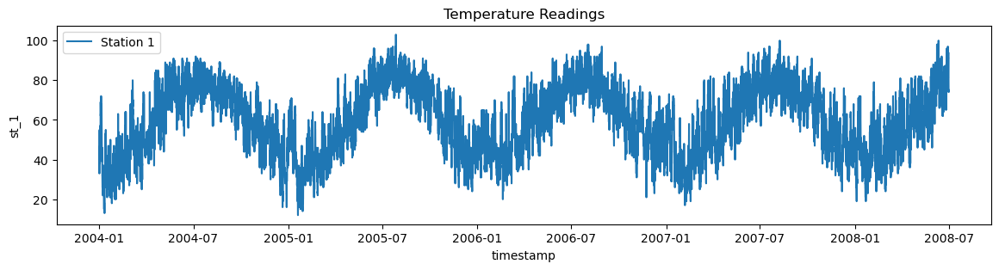

In [86]:
# Visualising how the temperature data looks like
fig, ax = plt.subplots(figsize=(14, 3))
sns.lineplot(data=temperature_pivot, x="timestamp", y="st_1", ax=ax, label="Station 1")
ax.set_title("Temperature Readings")
plt.show()

In [66]:
# Rows are less than 39,600
temperature_pivot.shape

(39432, 12)

In [87]:
# Merging load and temperature dataframes

load_temp_combined = pd.merge(temperature_pivot, load_long_pivot, on='timestamp', how='inner')
load_temp_combined.head()

,timestamp,st_1,st_2,st_3,st_4,st_5,st_6,st_7,st_8,st_9,...,zone_11,zone_12,zone_13,zone_14,zone_15,zone_16,zone_17,zone_18,zone_19,zone_20
0,2004-01-01 00:30:00,46.0,38.0,44.0,45.0,42.0,44.0,45.0,43.0,41.0,...,90700.0,118378.0,20673.0,21791.0,65970.0,28752.0,30645.0,200946.0,82298.0,79830.0
1,2004-01-01 01:30:00,46.0,36.0,42.0,43.0,42.0,43.0,44.0,44.0,39.0,...,86699.0,112480.0,19666.0,21400.0,64600.0,27851.0,30461.0,195835.0,79827.0,77429.0
2,2004-01-01 02:30:00,45.0,35.0,40.0,41.0,40.0,42.0,41.0,42.0,36.0,...,84243.0,108435.0,19020.0,20998.0,63843.0,27631.0,30197.0,194093.0,77728.0,75558.0
3,2004-01-01 03:30:00,41.0,30.0,36.0,37.0,39.0,38.0,40.0,34.0,35.0,...,84285.0,107224.0,18841.0,21214.0,64023.0,27986.0,30264.0,194708.0,76433.0,75709.0
4,2004-01-01 04:30:00,39.0,30.0,34.0,33.0,40.0,38.0,35.0,30.0,33.0,...,86087.0,108870.0,19310.0,21830.0,65679.0,29160.0,30907.0,202458.0,78172.0,77475.0


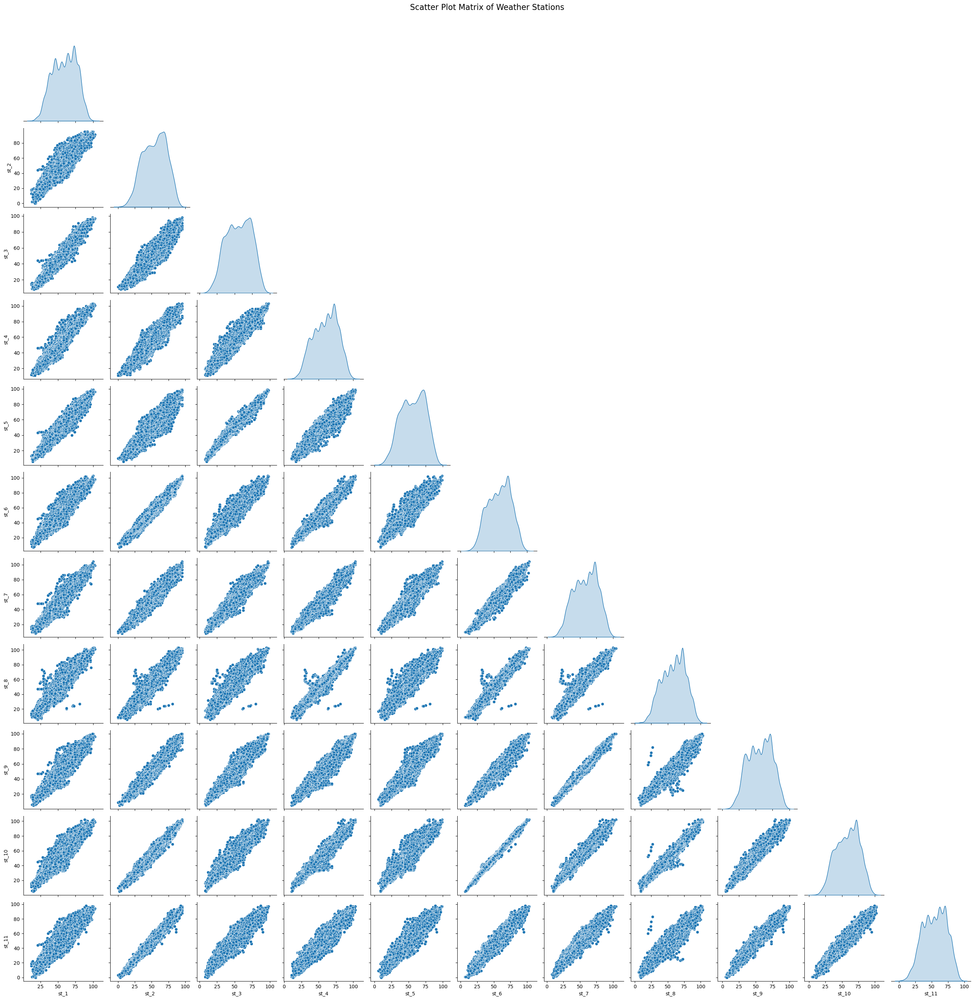

In [68]:
# Are weather temperatures reported by stations significantly different?

sns.pairplot(load_temp_combined.iloc[:,1:12], diag_kind='kde', corner=True)
plt.suptitle("Scatter Plot Matrix of Weather Stations", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

- They all appear to have high correlation with each other. So, it is not expected that temperature readings will vary significantly for different stations.
- It is possible that I might need to take some form of aggregate measure from different stations.
- It needs to be checked that which stations are strongly related to load data.

In [88]:
## Calculate the Correlation Matrix for Temp
correlation_matrix_temp = load_temp_combined.iloc[:,1:12].corr()
correlation_matrix_temp.head()

,st_1,st_2,st_3,st_4,st_5,st_6,st_7,st_8,st_9,st_10,st_11
st_1,1.000000,0.943141,0.980046,0.973645,0.977097,0.958015,0.965370,0.961762,0.956002,0.956611,0.940581
st_2,0.943141,1.000000,0.957310,0.962083,0.951411,0.985384,0.977334,0.967604,0.980405,0.986528,0.990752
st_3,0.980046,0.957310,1.000000,0.969260,0.992484,0.963283,0.977472,0.964397,0.973729,0.963854,0.957912
st_4,0.973645,0.962083,0.969260,1.000000,0.962086,0.982835,0.976198,0.989808,0.967282,0.981635,0.955277
st_5,0.977097,0.951411,0.992484,0.962086,1.000000,0.956629,0.972488,0.956580,0.968659,0.956833,0.952784


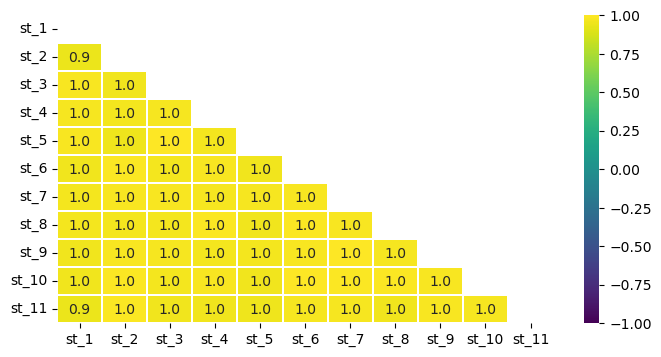

In [93]:
mask = np.triu(np.ones_like(correlation_matrix_temp, dtype=bool))

plt.figure(figsize=(8, 4))

sns.heatmap(
    correlation_matrix_temp,
    mask=mask,               # Apply the mask to hide the upper triangle
    annot=True,
    fmt=".1f",
    cmap='viridis',
    vmin=-1, 
    vmax=1, 
    linewidths=.01
)

plt.show()

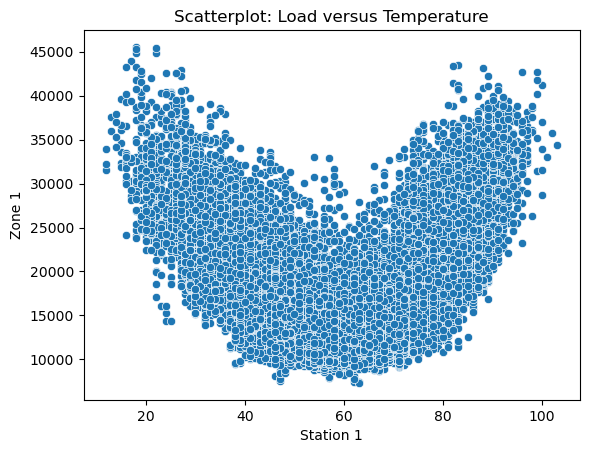

In [94]:
# There appears to be a non-linear relationship between temperature and load (Zone 1 vs Station 1)
sns.scatterplot(load_temp_combined,x="st_1",y="zone_1")
plt.title("Scatterplot: Load versus Temperature")
plt.xlabel("Station 1")
plt.ylabel("Zone 1")
plt.show()

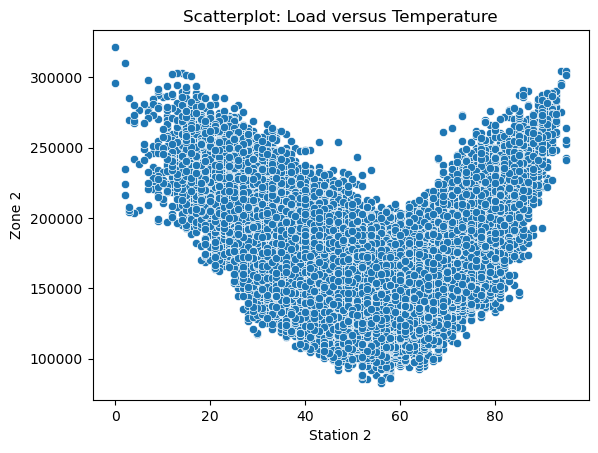

In [95]:
# There appears to be a non-linear relationship between temperature and load (Zone 2 vs Station 2)
sns.scatterplot(load_temp_combined,x="st_2",y="zone_2")
plt.title("Scatterplot: Load versus Temperature")
plt.xlabel("Station 2")
plt.ylabel("Zone 2")
plt.show()

The non-linearity could be due to seasonality, where the relationship could be changing due to summer or winter months.

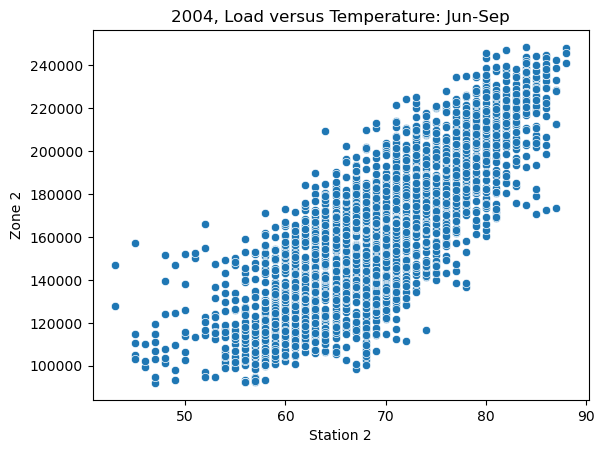

In [96]:
# Relationship in the monsoon months (Zone 2 vs Station 2)
sns.scatterplot(load_temp_combined.loc[(load_temp_combined["timestamp"].dt.year==2004)&(load_temp_combined["timestamp"].dt.month>=6)&(load_temp_combined["timestamp"].dt.month<=9)],x="st_2",y="zone_2")
plt.title("2004, Load versus Temperature: Jun-Sep")
plt.xlabel("Station 2")
plt.ylabel("Zone 2")
plt.show()

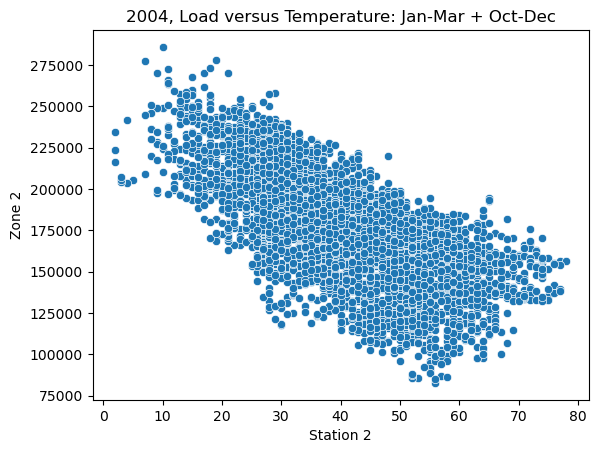

In [97]:
# Relationship in non-monsoon months (Zone 2 vs Station 2)
sns.scatterplot(load_temp_combined.loc[(load_temp_combined["timestamp"].dt.year==2004)&((load_temp_combined["timestamp"].dt.month<=3)|(load_temp_combined["timestamp"].dt.month>=10))],x="st_2",y="zone_2")
plt.title("2004, Load versus Temperature: Jan-Mar + Oct-Dec")
plt.xlabel("Station 2")
plt.ylabel("Zone 2")
plt.show()

This explains the weird shape of the scatterplot before. The variability in Apr (2004; zone 2 vs st 2) seems to be in both direction as shown below.

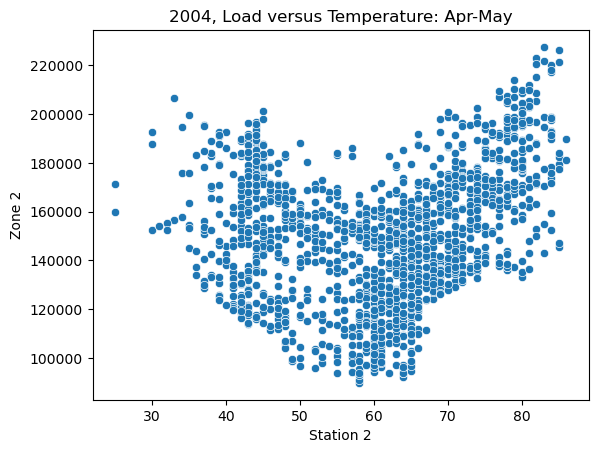

In [100]:
# Relationship in non-monsoon months (Zone 2 vs Station 2)
sns.scatterplot(load_temp_combined.loc[(load_temp_combined["timestamp"].dt.year==2004)&(load_temp_combined["timestamp"].dt.month>=4)&(load_temp_combined["timestamp"].dt.month<=5)],x="st_2",y="zone_2")
plt.title("2004, Load versus Temperature: Apr-May")
plt.xlabel("Station 2")
plt.ylabel("Zone 2")
plt.show()

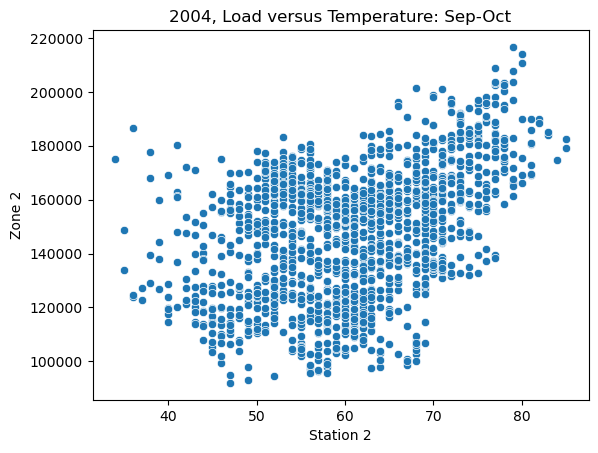

In [99]:
# Relationship in non-monsoon months (Zone 2 vs Station 2)
sns.scatterplot(load_temp_combined.loc[(load_temp_combined["timestamp"].dt.year==2004)&((load_temp_combined["timestamp"].dt.month>=9)&(load_temp_combined["timestamp"].dt.month<=10))],x="st_2",y="zone_2")
plt.title("2004, Load versus Temperature: Sep-Oct")
plt.xlabel("Station 2")
plt.ylabel("Zone 2")
plt.show()

Shoulder months show no clear relationship between temperature and load.

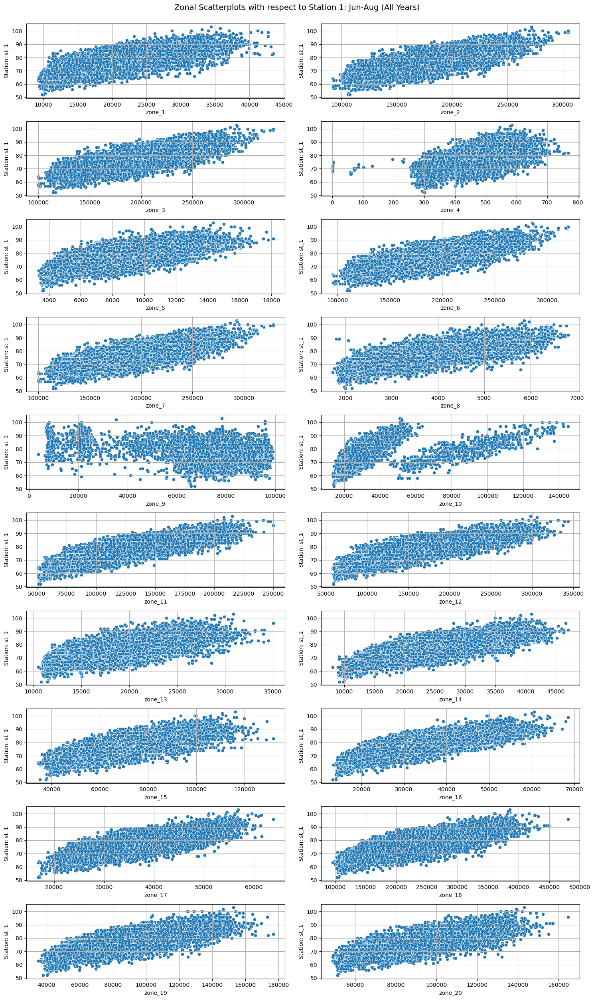

In [102]:
# Scatterplot series with respect to Station 1

# Define target and features
target = 'st_1'
features = [col for col in load_temp_combined.loc[(load_temp_combined["timestamp"].dt.month>=6)&(load_temp_combined["timestamp"].dt.month<=8),["st_1","zone_1","zone_2","zone_3","zone_4","zone_5","zone_6","zone_7","zone_8","zone_9","zone_10","zone_11","zone_12","zone_13","zone_14","zone_15","zone_16","zone_17","zone_18","zone_19","zone_20"]].columns if col != target and col != 'timestamp']

# Set up plot grid
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(15, 25))
axes = axes.flatten()

# Loop through each feature
for i, feature in enumerate(features):
    ax = axes[i] if len(features) > 1 else axes
    sns.scatterplot(data=load_temp_combined.loc[(load_temp_combined["timestamp"].dt.month>=6)&(load_temp_combined["timestamp"].dt.month<=8),["st_1","zone_1","zone_2","zone_3","zone_4","zone_5","zone_6","zone_7","zone_8","zone_9","zone_10","zone_11","zone_12","zone_13","zone_14","zone_15","zone_16","zone_17","zone_18","zone_19","zone_20"]], x=feature, y=target, ax=ax)
    ax.set_xlabel(feature)
    ax.set_ylabel(f"Station: {target}")
    ax.grid(True)

fig.suptitle("Zonal Scatterplots with respect to Station 1: Jun-Aug (All Years)",fontsize=14, y=1.0)
plt.tight_layout()
plt.show()

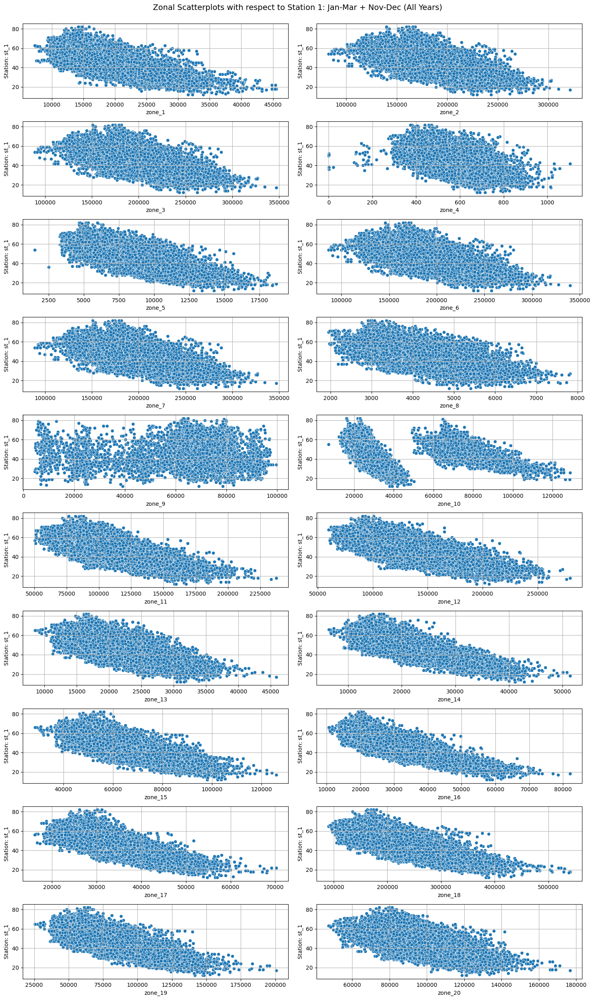

In [104]:
# Scatterplot series with respect to Station 1

# Define target and features
target = 'st_1'
features = [col for col in load_temp_combined.loc[(load_temp_combined["timestamp"].dt.month<=3)|(load_temp_combined["timestamp"].dt.month>=11),["st_1","zone_1","zone_2","zone_3","zone_4","zone_5","zone_6","zone_7","zone_8","zone_9","zone_10","zone_11","zone_12","zone_13","zone_14","zone_15","zone_16","zone_17","zone_18","zone_19","zone_20"]].columns if col != target and col != 'timestamp']

# Set up plot grid
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(15, 25))
axes = axes.flatten()

# Loop through each feature
for i, feature in enumerate(features):
    ax = axes[i] if len(features) > 1 else axes
    sns.scatterplot(data=load_temp_combined.loc[(load_temp_combined["timestamp"].dt.month<=3)|(load_temp_combined["timestamp"].dt.month>=11),["st_1","zone_1","zone_2","zone_3","zone_4","zone_5","zone_6","zone_7","zone_8","zone_9","zone_10","zone_11","zone_12","zone_13","zone_14","zone_15","zone_16","zone_17","zone_18","zone_19","zone_20"]], x=feature, y=target, ax=ax)
    ax.set_xlabel(feature)
    ax.set_ylabel(f"Station: {target}")
    ax.grid(True)

fig.suptitle("Zonal Scatterplots with respect to Station 1: Jan-Mar + Nov-Dec (All Years)",fontsize=14, y=1.0)
plt.tight_layout()
plt.show()

- Except for zones 9 and 10, most zones are behaving as expected.
- Zone 4 might be a little out of shape because of some missing values.
- There are two periods where the direction of correlation is changing:
    - Apr-May
    - Sep-Oct

As a way to accomomodate weather stations for a given zone, weighted average of stations can be taken where weights correspond to correlation with a given zone. So, we would weight a station based on its influence on a zone (temperature information would be a linear combination).<br><br>
The problem is to figure out a way to accommodate seasonality.

#### Autocorrelation - Hourly lags by season
Testing the correlation with lagged values. We have observed seasonality at two levels:
- Hourly (Similar values for a fixed hour)
- By Season (Warmer months tend to have slightly different usage patterns than colder months)

In ACF plots, width of confidence intervals is directly related to series length. For very long series, width would become very small which would make the assessment for correlation at prior lags misleading.

Since there are 4 seasons annually, ACF plots are created in each of these seasons: Winter, Spring, Summer & Autumn to observe the ACF structure.

##### Zone 1

Text(0, 0.5, 'ACF')

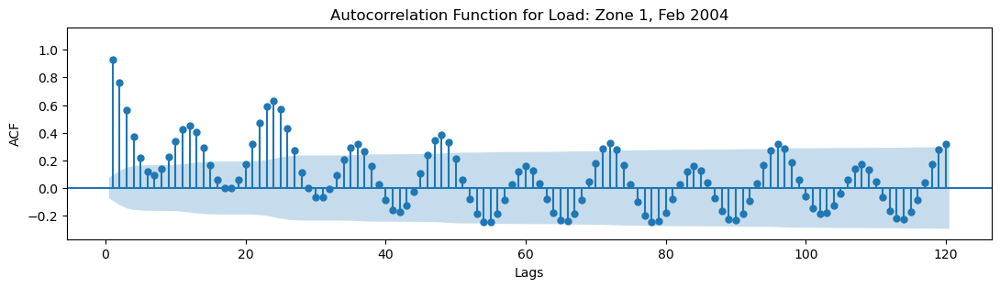

In [109]:
# Observing the ACF plot - Only for zone 1 (2004); subsetting the data for Feb 2004
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2004)&(load_long["month"]==2),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Feb 2004")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

Lags appear to be mostly significant till lag 72 (3 days prior). Magnitude of correlation isn't that high beyond lag 48.

Text(0, 0.5, 'ACF')

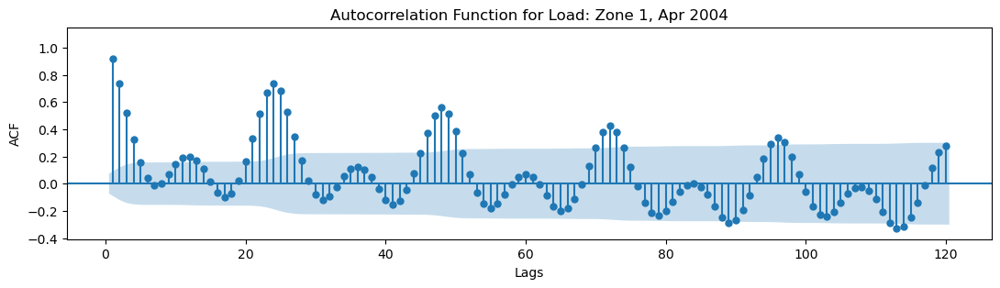

In [106]:
# Observing the ACF plot - Only for zone 1 (2004); subsetting the data for Apr 2004
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2004)&(load_long["month"]==4),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Apr 2004")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

Lags appear to be mostly significant till lag 72 (3 days prior). Magnitude of correlation isn't that high beyond lag 48.

Text(0, 0.5, 'ACF')

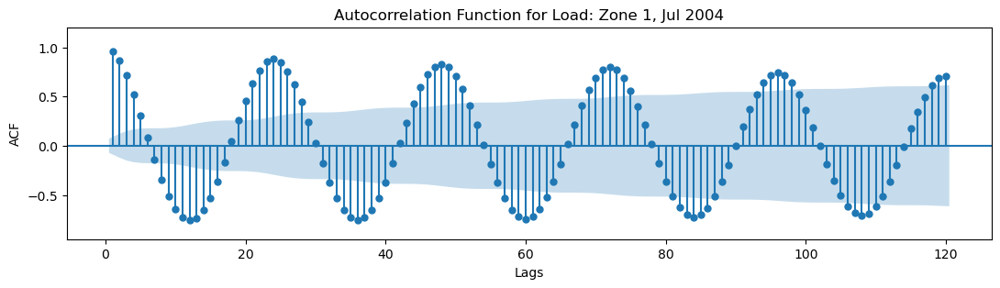

In [107]:
# Observing the ACF plot - Only for zone 1 (2004); subsetting the data for Jul 2004
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2004)&(load_long["month"]==7),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Jul 2004")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

The lags beyond lag 72 appear to be more significant here. More importantly, magnitude of correlation is much higher compared to previous case.

Text(0, 0.5, 'ACF')

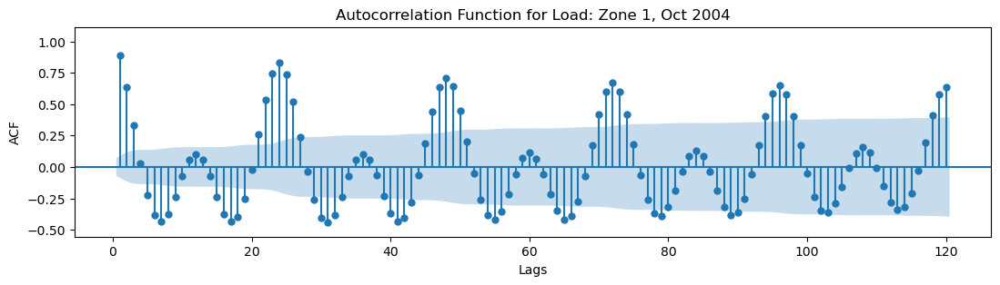

In [108]:
# Observing the ACF plot - Only for zone 1 (2004); subsetting the data for Oct 2004
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2004)&(load_long["month"]==10),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Oct 2004")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

The lags beyond lag 72 appear to be more significant here too. Magnitude of correlation are high here as well.

Text(0, 0.5, 'ACF')

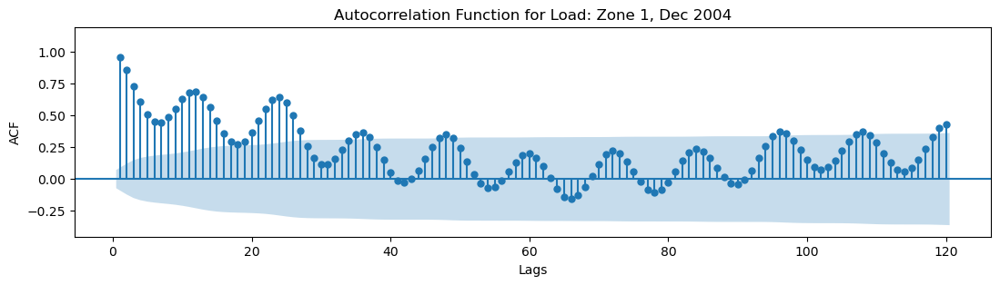

In [111]:
# Observing the ACF plot - Only for zone 1 (2004); subsetting the data for Dec 2004
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2004)&(load_long["month"]==12),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Dec 2004")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

Here in the winter month, the ACF appears to have decayed very early. It is there only till lag 48. Magnitude of correlation isn't that high beyond lag 24.

Text(0, 0.5, 'ACF')

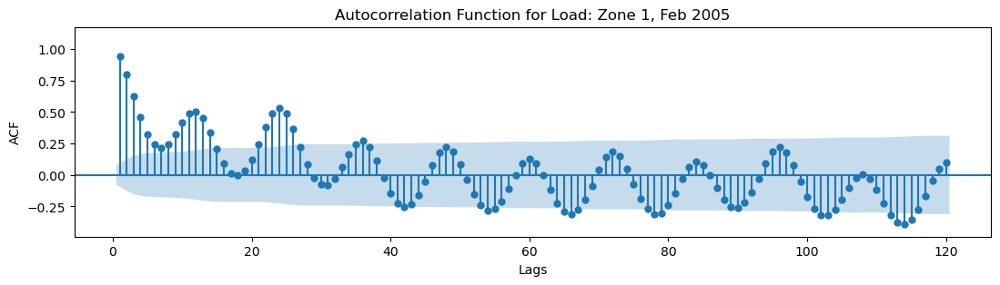

In [112]:
# Observing the ACF plot - Only for zone 1 (2005); subsetting the data for Feb 2005
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2005)&(load_long["month"]==2),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Feb 2005")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

Again, ACF decays pretty early. Magnitude of correlation isn't that high beyond lag 24.

Text(0, 0.5, 'ACF')

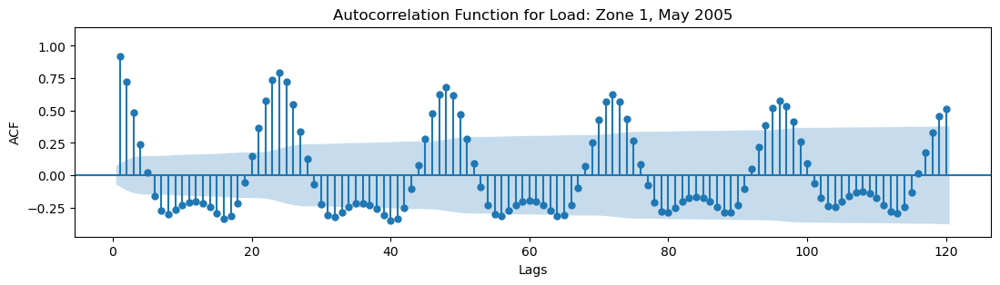

In [113]:
# Observing the ACF plot - Only for zone 1 (2005); subsetting the data for May 2005
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2005)&(load_long["month"]==5),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, May 2005")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

ACF decay appears a bit less, compared to previous winter. Magnitude of correlation increases a bit.

Text(0, 0.5, 'ACF')

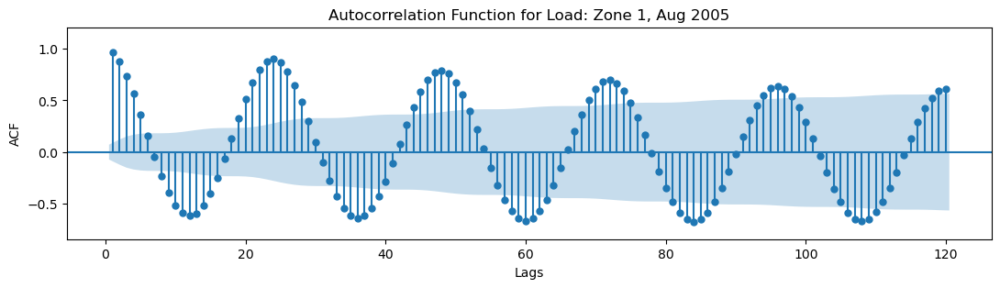

In [114]:
# Observing the ACF plot - Only for zone 1 (2005); subsetting the data for Aug 2005
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2005)&(load_long["month"]==8),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Aug 2005")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

For Summer, the lag significance is similar but the ACF structure appears to be a bit different. Magnitude of correlation becomes very high.

Text(0, 0.5, 'ACF')

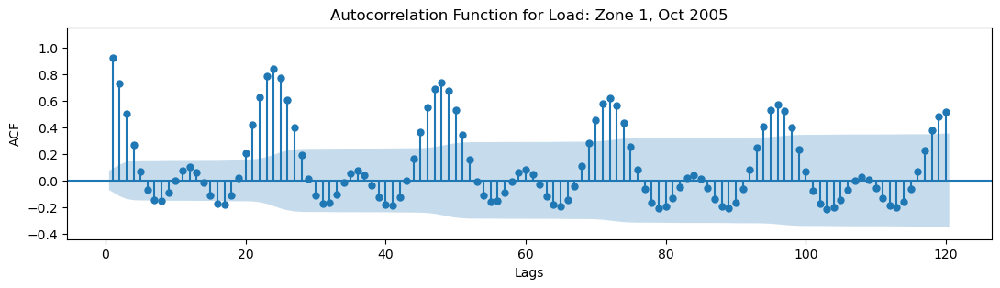

In [117]:
# Observing the ACF plot - Only for zone 1 (2005); subsetting the data for Oct 2005
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2005)&(load_long["month"]==10),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Oct 2005")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

Text(0, 0.5, 'ACF')

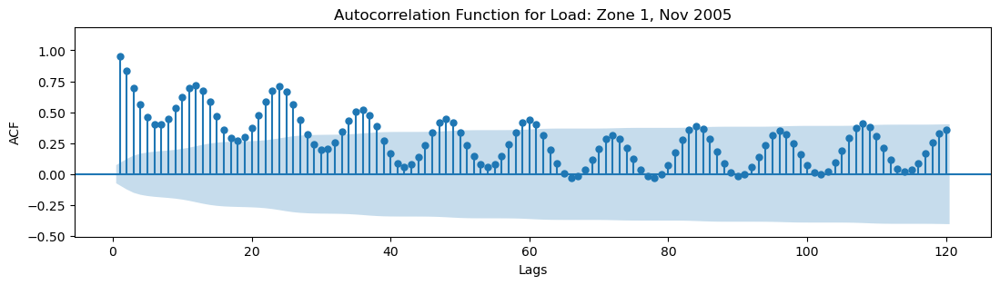

In [116]:
# Observing the ACF plot - Only for zone 1 (2005); subsetting the data for Nov 2005
from statsmodels.graphics.tsaplots import plot_acf

fig, ax = plt.subplots(figsize=(13,3))
plot_acf(load_long.sort_values(by="timestamp").loc[(load_long["zone_id"]==1)&(load_long["year"]==2005)&(load_long["month"]==11),"load"], 
         lags=120, # lags for last 5 days
         ax=ax,
         zero=False, 
         bartlett_confint=True, 
         auto_ylims=True)

ax.set_title("Autocorrelation Function for Load: Zone 1, Nov 2005")
ax.set_xlabel("Lags")
ax.set_ylabel("ACF")

<b> What can be said from looking at ACF plots? </b>

- There is significant serial/ autocorrelation here.
- Every 24th lag seems significant (strong daily seasonality):
    - lag 24
    - lag 48
    - lag 72...
- ACF is always sinusoidal (strong harmonic component), but the magnitude of correlation is changing depending on the season.
- The ACF structure appears to depend on the season (seasonal dependence):
    - In Winter (Nov to Feb), decay seems to happen quickly [Low Correlation]
    - In Spring (Mar to May), decay is a little slow i.e. past lags are a bit more significant [Medium Correlation]
    - In Summer (Jun to Aug), decay is slowest [High Correlation]
    - In Autumn (Sep to Oct), decay increases very slighty compared to summer [Medium Correlation]

Since ACF structure (magnitude of correl and lag significance) is varying by season, the series is non-stationary.